In [1]:
import os
import pandas as pd
import networkx as nx
from networkx.algorithms import bipartite

import matplotlib.pyplot as plt
%matplotlib inline

from itertools import combinations
from nxviz.plots import CircosPlot
import networkx.algorithms.community as nxcom
# TODO: Verificar seleção de empresas do DATASET

In [2]:
FULL_DATA_DIR = os.path.join("data", "full")
DATA_DIR = "data"

# Empresas de Educação ativas (CNAE 85)
EDU_COMPANIES_CNAES_FILE = os.path.join(DATA_DIR, "edu_empresas_cnaes.csv")
EDU_ACTIVE_PARTNERS_FILE = os.path.join(DATA_DIR, "edu_socios_ativos.csv")

# empresas de educação ativas com CNAE 851 a 854
FORMAL_EDU_COMPANIES_FILE = os.path.join(DATA_DIR, "formal_edu_empresas.csv")
# sócios das empresas de educação ativas com CNAE 851 a 854
FORMAL_EDU_PARTNERS_FILE = os.path.join(DATA_DIR, "formal_edu_socios.csv")


PARTNERS_FILE = os.path.join(FULL_DATA_DIR, "socios.csv")


FUNDAMENTAL_CODE = '851'
MEDIO_CODE = '852'
SUPERIOR_CODE = '853'
TECNICO_CODE = '854'
APOIO_CODE = '855'
OUTRAS_CODE = '859'

CLASSES = [FUNDAMENTAL_CODE, MEDIO_CODE, SUPERIOR_CODE, TECNICO_CODE, APOIO_CODE, OUTRAS_CODE]

COMPANIES_COLS = ['cnpj', 'matriz_filial', 'razao_social', 'nome_fantasia',
       'situacao', 'nome_pais', 'cod_nat_juridica', 'cnae_fiscal',
       'uf', 'qualif_resp', 'capital_social', 'porte']

COMPANIES_COLS.extend(CLASSES)

ACTIVE_CODE = 2
INDIVIDUAL_ENTREPRENEUR_CODE = 2135

In [3]:
COMPANIES_PARTNERS_GRAPH = os.path.join(DATA_DIR, "grafo_empresas_socios.gexf")


RAZAO_SOCIAL = 'razao_social' 
MATRIZ_FILIAL = 'matriz_filial' 
CAPITAL_SOCIAL = 'capital_social'
CNPJ_CPF_SOCIO = 'cnpj_cpf_socio'
TIPO_SOCIO = 'tipo_socio'
NOME_SOCIO = 'nome_socio'
ID_SOCIO = 'id_socio'

CNPJ = 'cnpj'

PESSOA_JURIDICA = 1
PESSOA_FISICA = 2
ESTRANGEIRO = 3

SOCIO_DE = 'socio_de'
N_SOCIOS = 'n_socios'

In [5]:
GRAFO_FORMAL_SOCIOS_EMPRESA = os.path.join(DATA_DIR, "grafo_formal_socios_empresas.gexf")
GRAFO_SOCIOS_FILE = os.path.join(DATA_DIR, "grafo_socios_socios.gexf")
GRAFO_EMPRESAS_FILE = os.path.join(DATA_DIR, "grafo_empresas_empresas.gexf")

In [4]:
df_full_companies = pd.read_csv(EDU_COMPANIES_CNAES_FILE, usecols=COMPANIES_COLS)
# apenas empresas ATIVAS
df_full_companies = df_full_companies[df_full_companies.situacao == 2] 
df_full_companies

/Users/hallpaz/Workspace/python/who-owns-brazilian-education/venv/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (9) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,cnpj,matriz_filial,razao_social,nome_fantasia,situacao,nome_pais,cod_nat_juridica,cnae_fiscal,uf,qualif_resp,capital_social,porte,851,852,853,854,855,859
0,39000109,1,MISSAO RAMA DO BRASIL,NaN,2,NaN,3999,8520100,SP,16,0.0,5,0,1,0,0,0,0
3,66000181,1,ASSOCIACAO BENEFICENTE LUZ DE UM NOVO DIA,NaN,2,NaN,3999,8511200,SP,16,0.0,5,3,0,0,0,0,0
10,130000124,1,CLUBE DAS MAES CARENTES DA SHEAB I,NaN,2,NaN,3999,8511200,SP,16,0.0,5,1,0,0,0,0,0
11,138000271,2,INSTITUTO ESTER GOMES,CEI GABRIELA MISTRAL,2,NaN,3999,8511200,SP,16,0.0,5,1,0,0,0,0,0
12,138000352,2,INSTITUTO ESTER GOMES,CEI TIA DORINHA,2,NaN,3999,8511200,SP,16,0.0,5,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1502159,98042120000156,1,COOPERATIVA AGRO-PECUARIA ALTO URUGUAI LTDA EM...,COTRIMAIO,2,NaN,2143,4789099,RS,13,0.0,5,0,0,0,0,0,1
1502160,98759046000193,1,SOCIEDADE ESPIRITA SIMAO PEDRO,NaN,2,NaN,3999,9491000,RS,16,0.0,5,0,0,0,0,0,1
1502161,98760572000173,1,ASSISTENCIA SOCIAL SANTA ISABEL,NaN,2,NaN,3999,8800600,RS,16,0.0,5,0,0,0,0,0,1
1502162,98760572000254,2,ASSISTENCIA SOCIAL SANTA ISABEL,NaN,2,NaN,3999,8800600,RS,16,0.0,5,0,0,0,0,0,1


In [5]:
df_companies = df_full_companies[(df_full_companies[FUNDAMENTAL_CODE] +
                                  df_full_companies[MEDIO_CODE] +
                                  df_full_companies[SUPERIOR_CODE] +
                                  df_full_companies[TECNICO_CODE]) > 0]
df_companies

,cnpj,matriz_filial,razao_social,nome_fantasia,situacao,nome_pais,cod_nat_juridica,cnae_fiscal,uf,qualif_resp,capital_social,porte,851,852,853,854,855,859
0,39000109,1,MISSAO RAMA DO BRASIL,NaN,2,NaN,3999,8520100,SP,16,0.0,5,0,1,0,0,0,0
3,66000181,1,ASSOCIACAO BENEFICENTE LUZ DE UM NOVO DIA,NaN,2,NaN,3999,8511200,SP,16,0.0,5,3,0,0,0,0,0
10,130000124,1,CLUBE DAS MAES CARENTES DA SHEAB I,NaN,2,NaN,3999,8511200,SP,16,0.0,5,1,0,0,0,0,0
11,138000271,2,INSTITUTO ESTER GOMES,CEI GABRIELA MISTRAL,2,NaN,3999,8511200,SP,16,0.0,5,1,0,0,0,0,0
12,138000352,2,INSTITUTO ESTER GOMES,CEI TIA DORINHA,2,NaN,3999,8511200,SP,16,0.0,5,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1501882,97538216000147,1,VANESSA GARDEN PAISAGISMO E DECORACOES EIRELI,VANESSA GARDEN PAISAGISMO E DECORACOES EIRELI,2,NaN,2305,4789002,SP,65,9370000.0,1,0,0,0,1,0,0
1501931,97542362000146,1,MAXILO CENTER CLINICA E EDUCACAO PROFISSIONAL ...,CLINICA STATTO,2,NaN,2062,8630504,MT,49,3000000.0,3,0,0,1,1,0,0
1502049,97548932000105,1,SOCIEDADE DE ESTUDOS BIBLICOS INTERDISCIPLINARES,SEBI,2,NaN,3999,9499500,DF,16,0.0,5,0,1,1,0,1,2
1502075,97550372000123,1,2W SERVICOS DE INFORMACOES E LOCACOES LTDA,MELHOR NEGOCIO,2,NaN,2062,8211300,MS,49,10000000.0,1,0,0,0,1,0,2


In [6]:
df_companies.to_csv(FORMAL_EDU_COMPANIES_FILE)

## Seleção dos sócios das empresas no ramo de educação formal

In [7]:
# Selecting EDU partners
chk_size = 100000
iter_partners = pd.read_csv(PARTNERS_FILE, iterator=True, chunksize=chk_size)
index = 0
edu_cnpjs = df_companies.cnpj
for chunk in iter_partners:
    edu_chunk = chunk[chunk['cnpj'].isin(edu_cnpjs)] #CNAE starting with 85
    edu_chunk.to_csv(FORMAL_EDU_PARTNERS_FILE, mode='a', header= True if index == 0 else False)
    index = index + 1
    if index%10 == 0:
        print("chunk number:" , index, "Lines processed:", index*chk_size)
print("Total chunks processed:", index)

/Users/hallpaz/Workspace/python/who-owns-brazilian-education/venv/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (9,10) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


chunk number: 10 Lines processed: 1000000
chunk number: 20 Lines processed: 2000000
chunk number: 30 Lines processed: 3000000
chunk number: 40 Lines processed: 4000000
chunk number: 50 Lines processed: 5000000
chunk number: 60 Lines processed: 6000000
chunk number: 70 Lines processed: 7000000
chunk number: 80 Lines processed: 8000000
chunk number: 90 Lines processed: 9000000
chunk number: 100 Lines processed: 10000000
chunk number: 110 Lines processed: 11000000
chunk number: 120 Lines processed: 12000000
chunk number: 130 Lines processed: 13000000
chunk number: 140 Lines processed: 14000000
chunk number: 150 Lines processed: 15000000
chunk number: 160 Lines processed: 16000000
chunk number: 170 Lines processed: 17000000
chunk number: 180 Lines processed: 18000000
chunk number: 190 Lines processed: 19000000
chunk number: 200 Lines processed: 20000000
chunk number: 210 Lines processed: 21000000
chunk number: 220 Lines processed: 22000000
chunk number: 230 Lines processed: 23000000
chunk 

In [24]:
df_formal_partners = pd.read_csv(FORMAL_EDU_PARTNERS_FILE, index_col=0)
df_formal_partners

,cnpj,tipo_socio,nome_socio,cnpj_cpf_socio,cod_qualificacao,perc_capital,data_entrada,cod_pais_ext,nome_pais_ext,cpf_repres,nome_repres,cod_qualif_repres
353801,14000105,2,ANTONIO OLIVEIRA DA SILVA,***439608**,16,0.0,20140714,249.0,ESTADOS UNIDOS,NaN,NaN,0
353802,14000296,2,ANTONIO OLIVEIRA DA SILVA,***439608**,16,0.0,20140714,863.0,"VIRGENS, ILHAS (BRITANICAS)",NaN,NaN,0
353803,14000377,2,ANTONIO OLIVEIRA DA SILVA,***439608**,16,0.0,20140714,573.0,Países Baixos (Holanda),NaN,NaN,0
353826,39000109,2,CARLOS ROBERTO PAZ WELLS,***835158**,16,0.0,20050912,249.0,ESTADOS UNIDOS,NaN,NaN,0
353850,48000108,2,PAULO CESAR GOMES,***471268**,16,0.0,20151106,249.0,ESTADOS UNIDOS,NaN,NaN,0
353866,66000181,2,JOSE PELEGATTI NETO,***955548**,16,0.0,20181122,249.0,ESTADOS UNIDOS,NaN,NaN,0
353948,130000124,2,MARCIO ROSA DE ARAUJO,***958318**,16,0.0,20160502,249.0,ESTADOS UNIDOS,NaN,NaN,0
353954,138000190,2,REGILENE GOMES RODRIGUES,***200518**,16,0.0,20130718,249.0,ESTADOS UNIDOS,NaN,NaN,0
353955,138000271,2,REGILENE GOMES RODRIGUES,***200518**,16,0.0,20130718,137.0,"CAYMAN,ILHAS",NaN,NaN,0
353956,138000352,2,REGILENE GOMES RODRIGUES,***200518**,16,0.0,20130718,137.0,"CAYMAN,ILHAS",NaN,NaN,0


---

## Redução de colunas e tratamento do tipo dos dados para evitar problemas

In [25]:
df_companies = pd.read_csv(FORMAL_EDU_COMPANIES_FILE, index_col=0)

In [26]:
df_companies.cnpj = df_companies.cnpj.astype(str)

In [27]:
df_companies

,cnpj,matriz_filial,razao_social,nome_fantasia,situacao,nome_pais,cod_nat_juridica,cnae_fiscal,uf,qualif_resp,capital_social,porte,851,852,853,854,855,859
0,39000109,1,MISSAO RAMA DO BRASIL,NaN,2,NaN,3999,8520100,SP,16,0.0,5,0,1,0,0,0,0
3,66000181,1,ASSOCIACAO BENEFICENTE LUZ DE UM NOVO DIA,NaN,2,NaN,3999,8511200,SP,16,0.0,5,3,0,0,0,0,0
10,130000124,1,CLUBE DAS MAES CARENTES DA SHEAB I,NaN,2,NaN,3999,8511200,SP,16,0.0,5,1,0,0,0,0,0
11,138000271,2,INSTITUTO ESTER GOMES,CEI GABRIELA MISTRAL,2,NaN,3999,8511200,SP,16,0.0,5,1,0,0,0,0,0
12,138000352,2,INSTITUTO ESTER GOMES,CEI TIA DORINHA,2,NaN,3999,8511200,SP,16,0.0,5,1,0,0,0,0,0
13,138000433,2,INSTITUTO ESTER GOMES,CENTRO DE EDUCACAO INFANTIL - CEI ESTRELA DO MAR,2,NaN,3999,8511200,SP,16,0.0,5,1,0,0,0,0,0
14,144000229,2,ASSCOMAT - ASSOCIACAO COMUNITARIA ATITUDE,CEI ATITUDE DE CRIANCA,2,NaN,3999,8511200,SP,16,0.0,5,1,0,0,0,0,0
17,210000180,1,ESCOLA DE EDUCACAO INFANTIL INTERMUNDI LTDA,INTERMUNDI,2,NaN,2062,8512100,SP,49,0.0,3,2,0,0,0,0,0
18,215000102,1,COLEGIO FELICIA DE SOUSA LTDA,E. E. I. URSINHO PUFF,2,NaN,2062,8512100,SP,49,300000.0,1,3,0,0,0,0,0
29,473000199,1,COLEGIO FORTES'S S/S LTDA,TUTI FRUTI,2,NaN,2240,8513900,SP,49,1000000.0,1,1,0,0,0,0,0


In [28]:
df_formal_partners.cnpj = df_formal_partners.cnpj.astype(str)
df_formal_partners.cnpj_cpf_socio = df_formal_partners.cnpj_cpf_socio.astype(str)
df_formal_partners[ID_SOCIO] = (df_formal_partners.cnpj_cpf_socio + df_formal_partners.apply(
                                lambda x: x.nome_socio if x.tipo_socio == PESSOA_FISICA else "", axis=1) 
                              )
df_formal_partners.head()

,cnpj,tipo_socio,nome_socio,cnpj_cpf_socio,cod_qualificacao,perc_capital,data_entrada,cod_pais_ext,nome_pais_ext,cpf_repres,nome_repres,cod_qualif_repres,id_socio
353801,14000105,2,ANTONIO OLIVEIRA DA SILVA,***439608**,16,0.0,20140714,249.0,ESTADOS UNIDOS,NaN,NaN,0,***439608**ANTONIO OLIVEIRA DA SILVA
353802,14000296,2,ANTONIO OLIVEIRA DA SILVA,***439608**,16,0.0,20140714,863.0,"VIRGENS, ILHAS (BRITANICAS)",NaN,NaN,0,***439608**ANTONIO OLIVEIRA DA SILVA
353803,14000377,2,ANTONIO OLIVEIRA DA SILVA,***439608**,16,0.0,20140714,573.0,Países Baixos (Holanda),NaN,NaN,0,***439608**ANTONIO OLIVEIRA DA SILVA
353826,39000109,2,CARLOS ROBERTO PAZ WELLS,***835158**,16,0.0,20050912,249.0,ESTADOS UNIDOS,NaN,NaN,0,***835158**CARLOS ROBERTO PAZ WELLS
353850,48000108,2,PAULO CESAR GOMES,***471268**,16,0.0,20151106,249.0,ESTADOS UNIDOS,NaN,NaN,0,***471268**PAULO CESAR GOMES


In [29]:
df_partners = df_formal_partners.loc[:,[CNPJ, ID_SOCIO, CNPJ_CPF_SOCIO, NOME_SOCIO, TIPO_SOCIO]]

In [30]:
df_partners = df_partners.merge(
    df_companies[[CNPJ, RAZAO_SOCIAL, MATRIZ_FILIAL, CAPITAL_SOCIAL]], how='left', on=CNPJ
)
df_partners = df_partners[
    [CNPJ, RAZAO_SOCIAL, MATRIZ_FILIAL, CAPITAL_SOCIAL, CNPJ_CPF_SOCIO, ID_SOCIO, NOME_SOCIO, TIPO_SOCIO]
]
df_partners

,cnpj,razao_social,matriz_filial,capital_social,cnpj_cpf_socio,id_socio,nome_socio,tipo_socio
0,14000105,CLUBE DE MAES DA CASA VERDE ALTA E ADJACENCIAS,1,0.0,***439608**,***439608**ANTONIO OLIVEIRA DA SILVA,ANTONIO OLIVEIRA DA SILVA,2
1,14000296,CLUBE DE MAES DA CASA VERDE ALTA E ADJACENCIAS,2,0.0,***439608**,***439608**ANTONIO OLIVEIRA DA SILVA,ANTONIO OLIVEIRA DA SILVA,2
2,14000377,CLUBE DE MAES DA CASA VERDE ALTA E ADJACENCIAS,2,0.0,***439608**,***439608**ANTONIO OLIVEIRA DA SILVA,ANTONIO OLIVEIRA DA SILVA,2
3,39000109,MISSAO RAMA DO BRASIL,1,0.0,***835158**,***835158**CARLOS ROBERTO PAZ WELLS,CARLOS ROBERTO PAZ WELLS,2
4,48000108,ASSOCIACAO VIRTUDE PLENA,1,0.0,***471268**,***471268**PAULO CESAR GOMES,PAULO CESAR GOMES,2
5,66000181,ASSOCIACAO BENEFICENTE LUZ DE UM NOVO DIA,1,0.0,***955548**,***955548**JOSE PELEGATTI NETO,JOSE PELEGATTI NETO,2
6,130000124,CLUBE DAS MAES CARENTES DA SHEAB I,1,0.0,***958318**,***958318**MARCIO ROSA DE ARAUJO,MARCIO ROSA DE ARAUJO,2
7,138000190,INSTITUTO ESTER GOMES,1,0.0,***200518**,***200518**REGILENE GOMES RODRIGUES,REGILENE GOMES RODRIGUES,2
8,138000271,INSTITUTO ESTER GOMES,2,0.0,***200518**,***200518**REGILENE GOMES RODRIGUES,REGILENE GOMES RODRIGUES,2
9,138000352,INSTITUTO ESTER GOMES,2,0.0,***200518**,***200518**REGILENE GOMES RODRIGUES,REGILENE GOMES RODRIGUES,2


In [31]:
# Por alguma razão há linhas que descrvem empresas como sócias de si mesmas.
df_partners[df_partners.cnpj == df_partners.id_socio]

,cnpj,razao_social,matriz_filial,capital_social,cnpj_cpf_socio,id_socio,nome_socio,tipo_socio
86384,10815349000135,TACTUS SERVICOS E COBRANCA LTDA,1,5.000000e+05,10815349000135,10815349000135,TACTUS SERVICOS E COBRANCA LTDA,1
92389,11471790000100,TAGGEN SISTEMAS DE INFORMACAO LTDA.,1,5.854970e+07,11471790000100,11471790000100,TAGGEN SISTEMAS DE INFORMACAO LTDA.,1
93917,11852633000144,IDEAL CURSOS PROFISSIONALIZANTES CAMPO GRANDE-...,1,5.000000e+06,11852633000144,11852633000144,IDEAL CURSOS PROFISSIONALIZANTES CAMPO GRANDE-...,1
94394,11987604000190,LAPA SISTEMA DE ENSINO LTDA,1,1.000000e+06,11987604000190,11987604000190,LAPA SISTEMA DE ENSINO LTDA,1
95853,12403332000104,"SOCIEDADE DE PSICOLOGIA, EDUCACAO, COMPORTAMEN...",1,4.900000e+06,12403332000104,12403332000104,"SOCIEDADE DE PSICOLOGIA, EDUCACAO, COMPORTAMEN...",1
96808,12650975000144,NEODNA - CURSOS PREPARATORIOS LTDA,1,5.000000e+06,12650975000144,12650975000144,NEODNA - CURSOS PREPARATORIOS LTDA,1
96823,12655143000110,LIVRE CONCEITO EDUCACAO E NEGOCIOS LTDA,1,9.000000e+04,12655143000110,12655143000110,LIVRE CONCEITO EDUCACAO E NEGOCIOS LTDA,1
98005,13010452000104,ALTEXX ASSESSORIA E REGULARIZACOES LTDA,1,3.000000e+06,13010452000104,13010452000104,ALTEXX ASSESSORIA E REGULARIZACOES LTDA,1
102792,14143257000107,COLEGIO AGAPE LTDA,1,3.000000e+06,14143257000107,14143257000107,COLEGIO AGAPE LTDA,1
103268,14296603000197,BERCARIO BABY CIDADE JARDIM LTDA,1,2.000000e+06,14296603000197,14296603000197,BERCARIO BABY CIDADE JARDIM LTDA,1


In [32]:
# Vamos remover esses casos de "auto-sociedade"
df_partners.drop(df_partners[df_partners.cnpj == df_partners.id_socio].index, inplace=True)
df_partners

,cnpj,razao_social,matriz_filial,capital_social,cnpj_cpf_socio,id_socio,nome_socio,tipo_socio
0,14000105,CLUBE DE MAES DA CASA VERDE ALTA E ADJACENCIAS,1,0.0,***439608**,***439608**ANTONIO OLIVEIRA DA SILVA,ANTONIO OLIVEIRA DA SILVA,2
1,14000296,CLUBE DE MAES DA CASA VERDE ALTA E ADJACENCIAS,2,0.0,***439608**,***439608**ANTONIO OLIVEIRA DA SILVA,ANTONIO OLIVEIRA DA SILVA,2
2,14000377,CLUBE DE MAES DA CASA VERDE ALTA E ADJACENCIAS,2,0.0,***439608**,***439608**ANTONIO OLIVEIRA DA SILVA,ANTONIO OLIVEIRA DA SILVA,2
3,39000109,MISSAO RAMA DO BRASIL,1,0.0,***835158**,***835158**CARLOS ROBERTO PAZ WELLS,CARLOS ROBERTO PAZ WELLS,2
4,48000108,ASSOCIACAO VIRTUDE PLENA,1,0.0,***471268**,***471268**PAULO CESAR GOMES,PAULO CESAR GOMES,2
5,66000181,ASSOCIACAO BENEFICENTE LUZ DE UM NOVO DIA,1,0.0,***955548**,***955548**JOSE PELEGATTI NETO,JOSE PELEGATTI NETO,2
6,130000124,CLUBE DAS MAES CARENTES DA SHEAB I,1,0.0,***958318**,***958318**MARCIO ROSA DE ARAUJO,MARCIO ROSA DE ARAUJO,2
7,138000190,INSTITUTO ESTER GOMES,1,0.0,***200518**,***200518**REGILENE GOMES RODRIGUES,REGILENE GOMES RODRIGUES,2
8,138000271,INSTITUTO ESTER GOMES,2,0.0,***200518**,***200518**REGILENE GOMES RODRIGUES,REGILENE GOMES RODRIGUES,2
9,138000352,INSTITUTO ESTER GOMES,2,0.0,***200518**,***200518**REGILENE GOMES RODRIGUES,REGILENE GOMES RODRIGUES,2


## Quantas Empresas são sócias de empresas com atividade em Educação?

In [17]:
df_companies_partners = df_partners[df_partners.tipo_socio == PESSOA_JURIDICA] 
len(df_companies_partners[ID_SOCIO].unique())

809

## Quantas dessas empresas declaram atividade econômica em Educação?

In [18]:
df_double_agent = df_companies_partners[df_companies_partners.id_socio.isin(df_partners.cnpj)]
print(len(df_double_agent.cnpj.unique()), "empresas na área")
df_double_agent

708 empresas na área


,cnpj,razao_social,matriz_filial,capital_social,cnpj_cpf_socio,id_socio,nome_socio,tipo_socio
243,78220000138,CENTRO DE ENSINO UNIFICADO DO DISTRITO FEDERAL...,1,1.209200e+09,62984091000102,62984091000102,CRUZEIRO DO SUL EDUCACIONAL S.A.,1
246,78220000219,CENTRO DE ENSINO UNIFICADO DO DISTRITO FEDERAL...,2,0.000000e+00,62984091000102,62984091000102,CRUZEIRO DO SUL EDUCACIONAL S.A.,1
493,111296000118,COLEGIO VIDA LTDA,1,1.628800e+07,56012628000161,56012628000161,SEB SISTEMA EDUCACIONAL BRASILEIRO S.A.,1
2796,619832000190,CEB CENTRO EDUCACIONAL BELTRONENSE LTDA,1,3.170000e+05,14011425000100,14011425000100,SISTEMA ELITE DE ENSINO S.A,1
4228,829603000109,OSWALDO CRUZ LABSERVICE LTDA,1,1.203300e+08,60704335000112,60704335000112,PROTECNICA PAULISTA LTDA,1
...,...,...,...,...,...,...,...,...
191572,86704160000560,QI - QUALIDADE INTEGRAL DE ENSINO LTDA,2,0.000000e+00,21219576000114,21219576000114,RAIZ EDUCACAO S.A.,1
191573,86704160000641,QI - QUALIDADE INTEGRAL DE ENSINO LTDA,2,0.000000e+00,21219576000114,21219576000114,RAIZ EDUCACAO S.A.,1
191576,86704160000722,QI - QUALIDADE INTEGRAL DE ENSINO LTDA,2,0.000000e+00,21219576000114,21219576000114,RAIZ EDUCACAO S.A.,1
191579,86704160000803,QI - QUALIDADE INTEGRAL DE ENSINO LTDA,2,0.000000e+00,21219576000114,21219576000114,RAIZ EDUCACAO S.A.,1


---

## Criação do Grafo de Relacionamento "É sócio de" entre CPF-CNPJ e CPNJ

In [19]:
# Grafo direcionado para expressar "é sócio de"
G_SE = nx.from_pandas_edgelist(df_partners, ID_SOCIO, CNPJ, create_using=nx.DiGraph)

In [24]:
nx.set_node_attributes(G_SE, dict(zip(df_partners.id_socio, df_partners.tipo_socio)), TIPO_SOCIO)

In [25]:
print(nx.info(G_SE))
print("Nós isolados: {}\nÉ bipartido: {}".format(list(nx.isolates(G_SE)), bipartite.is_bipartite(G_SE)))
print("Número de arestas de um nó para si mesmo: {}".format(nx.number_of_selfloops(G_SE)))

Name: 
Type: DiGraph
Number of nodes: 227596
Number of edges: 194494
Average in degree:   0.8546
Average out degree:   0.8546
Nós isolados: []
É bipartido: False
Número de arestas de um nó para si mesmo: 0


# Exporta o Grafo para um arquivo


In [26]:
nx.write_gexf(G_SE, GRAFO_FORMAL_SOCIOS_EMPRESA)

In [33]:
df_partners.to_csv("data/formal_edu_socios_pronto.csv")

---

# => Análises do GRAFO
## Quem são os sócios de mais empresas com atividades declaradas em Educação?

In [66]:
G_SE = nx.read_gexf(GRAFO_FORMAL_SOCIOS_EMPRESA)

In [74]:
full_out_degrees = [(n, G_SE.out_degree(n)) for n in G_SE.nodes]
print("Total de nós:", len(full_out_degrees))
full_out_degrees = [d for d in full_out_degrees if d[1] > 0]
print("Total de sócios:", len(full_out_degrees))

Total de nós: 227596
Total de sócios: 132472


In [82]:
sorted(full_out_degrees, key=lambda x: x[1], reverse=True)[0:10]

[('***616878**CARLOS ALBERTO BOLINA LAZAR', 625),
 ('***436968**ROBERTO AFONSO VALERIO NETO', 617),
 ('***225868**MARIO GHIO JUNIOR', 615),
 ('***153291**RODRIGO CALVO GALINDO', 548),
 ('***824308**JOAO CARLOS DI GENIO', 358),
 ('***109868**JORGE BRIHY', 316),
 ('***179838**FERNANDO DI GENIO BARBOSA', 300),
 ('38733648000140', 288),
 ('***815748**ANA IDA DI GENIO BARBOSA', 260),
 ('***031488**JOSE FERNANDO PINTO DA COSTA', 258)]

In [83]:
baron_companies = sorted([t for t in full_out_degrees if not t[0].startswith('*')], key=lambda x: x[1], reverse=True)
display(baron_companies[0:20])
print(len(baron_companies))

[('38733648000140', 288),
 ('04310392000146', 182),
 ('07728655000120', 166),
 ('05808792000149', 148),
 ('08432514000128', 131),
 ('08807432000110', 115),
 ('18570214000169', 92),
 ('04986320000113', 84),
 ('05478567000191', 80),
 ('17765891000170', 77),
 ('06099229000101', 62),
 ('20512706000140', 53),
 ('56012628000161', 43),
 ('26083507000140', 42),
 ('03239470000109', 38),
 ('19213316000190', 31),
 ('10305610000157', 31),
 ('62596408000125', 30),
 ('09288252000132', 27),
 ('15539941000175', 27)]

810


### Vamos decifrar esses números  em uma tabela

In [29]:
df_out = pd.DataFrame(out_degrees, columns=[ID_SOCIO, SOCIO_DE])
df_out = df_out.merge(
    df_partners[[ID_SOCIO, NOME_SOCIO]].groupby(ID_SOCIO).max(), how='left', on=ID_SOCIO
)
print(df_out.shape)

(132472, 3)


In [30]:
df_out.sort_values(by=[SOCIO_DE, NOME_SOCIO], ascending=False).head(20)

,id_socio,socio_de,nome_socio
2804,***616878**CARLOS ALBERTO BOLINA LAZAR,625,CARLOS ALBERTO BOLINA LAZAR
2805,***436968**ROBERTO AFONSO VALERIO NETO,617,ROBERTO AFONSO VALERIO NETO
2803,***225868**MARIO GHIO JUNIOR,615,MARIO GHIO JUNIOR
5561,***153291**RODRIGO CALVO GALINDO,548,RODRIGO CALVO GALINDO
398,***824308**JOAO CARLOS DI GENIO,358,JOAO CARLOS DI GENIO
396,***109868**JORGE BRIHY,316,JORGE BRIHY
8303,***179838**FERNANDO DI GENIO BARBOSA,300,FERNANDO DI GENIO BARBOSA
5562,38733648000140,288,EDITORA E DISTRIBUIDORA EDUCACIONAL S/A
8302,***815748**ANA IDA DI GENIO BARBOSA,260,ANA IDA DI GENIO BARBOSA
5211,***031488**JOSE FERNANDO PINTO DA COSTA,258,JOSE FERNANDO PINTO DA COSTA


## Quais são as Empresas que participam de mais empresas?

In [67]:
companies_out_degrees = [(n, G_SE.out_degree(n)) for n in G_SE.nodes if (
    (TIPO_SOCIO in G_SE.nodes[n]) and (G_SE.nodes[n][TIPO_SOCIO] == PESSOA_JURIDICA) )]
print("Total de nós:", len(companies_out_degrees))
companies_out_degrees = [d for d in companies_out_degrees if d[1] > 0]
print("Total de empresas sócias:", len(companies_out_degrees))

Total de nós: 809
Total de empresas sócias: 809


In [68]:
sorted(companies_out_degrees, key=lambda x: x[1], reverse=True)[0:10]

[('38733648000140', 288),
 ('04310392000146', 182),
 ('07728655000120', 166),
 ('05808792000149', 148),
 ('08432514000128', 131),
 ('08807432000110', 115),
 ('18570214000169', 92),
 ('04986320000113', 84),
 ('05478567000191', 80),
 ('17765891000170', 77)]

### Vamos decifrar esses números  em uma tabela

In [78]:
df_companies_out = pd.DataFrame(companies_out_degrees, columns=[ID_SOCIO, SOCIO_DE])
df_companies_out = df_companies_out.merge(
    df_partners[[ID_SOCIO, NOME_SOCIO]].groupby(ID_SOCIO).max(), how='left', on=ID_SOCIO
)
print(df_companies_out.shape)

(809, 3)


In [79]:
df_companies_out.sort_values(by=[SOCIO_DE, NOME_SOCIO], ascending=False).head(20)

,id_socio,socio_de,nome_socio
40,38733648000140,288,EDITORA E DISTRIBUIDORA EDUCACIONAL S/A
39,04310392000146,182,ANHANGUERA EDUCACIONAL PARTICIPACOES S/A
67,07728655000120,166,REDE INTERNACIONAL DE UNIVERSIDADES LAUREATE L...
116,05808792000149,148,ANHANGUERA EDUCACIONAL LTDA
68,08432514000128,131,"ICE INVERSIONES BRAZIL S.L., SOCIEDAD UNIPERSONAL"
81,08807432000110,115,ESTACIO PARTICIPACOES S/A
111,18570214000169,92,UNINASSAU PARTICIPACOES S.A.
110,04986320000113,84,SER EDUCACIONAL S.A.
115,05478567000191,80,ORME SERVICOS EDUCACIONAIS LTDA
14,17765891000170,77,ELEVA EDUCACAO S.A.


In [140]:
list(df_companies_out.sort_values(by=[SOCIO_DE, NOME_SOCIO], ascending=False).head(20)[NOME_SOCIO])

['EDITORA E DISTRIBUIDORA EDUCACIONAL S/A',
 'ANHANGUERA EDUCACIONAL PARTICIPACOES S/A',
 'REDE INTERNACIONAL DE UNIVERSIDADES LAUREATE LTDA.',
 'ANHANGUERA EDUCACIONAL LTDA',
 'ICE INVERSIONES BRAZIL S.L., SOCIEDAD UNIPERSONAL',
 'ESTACIO PARTICIPACOES S/A',
 'UNINASSAU PARTICIPACOES S.A.',
 'SER EDUCACIONAL S.A.',
 'ORME SERVICOS EDUCACIONAIS LTDA',
 'ELEVA EDUCACAO S.A.',
 'ASSUPERO ENSINO SUPERIOR LTDA.',
 'TREVISO EMPREENDIMENTOS E PARTICIPACOES S.A.',
 'SEB SISTEMA EDUCACIONAL BRASILEIRO S.A.',
 'SOMOS OPERACOES ESCOLARES S.A.',
 'PITAGORAS - SISTEMA DE EDUCACAO SUPERIOR SOCIEDADE LTDA',
 'HN INVESTIMENTOS E PARTICIPACOES EIRELI',
 'COLEGIO VIMASA S/A',
 'ISCP - SOCIEDADE EDUCACIONAL LTDA.',
 'PENSI EDUCACAO  E PARTICIPACOES SA',
 'ANIMA HOLDING S.A.']

In [ ]:
04310392000146', 182),
 ('07728655000120', 165),
 ('08432514000128', 160),
 ('05808792000149', 149),
 ('08807432000110', 115),
 ('18570214000169', 92),
 ('04986320000113', 84),
 ('05478567000191', 80),
 ('17765891000170', 78),
 ('06099229000101', 62)]

In [73]:
df_companies_out.sort_values(by=[SOCIO_DE, RAZAO_SOCIAL], ascending=False).head(20)

,id_socio,socio_de,razao_social
40,38733648000140,288,UNIME - UNIAO METROPOLITANA PARA O DESENVOLVIM...
39,04310392000146,182,UNIAO DE ENSINO UNOPAR LTDA
67,07728655000120,166,SODECAM -SOCIEDADE DE DESENVOLVIMENTO CULTURAL...
116,05808792000149,148,UNIC EDUCACIONAL LTDA
68,08432514000128,131,SODECAM -SOCIEDADE DE DESENVOLVIMENTO CULTURAL...
81,08807432000110,115,SOCIEDADE DE ENSINO SUPERIOR ESTACIO RIBEIRAO ...
111,18570214000169,92,SOCIEDADE UNIVERSITARIA MILETO LTDA
110,04986320000113,84,SOCIEDADE EDUCACIONAL CARVALHO GOMES LTDA
115,05478567000191,80,PROJECTA EDUCACIONAL LTDA
14,17765891000170,77,SOCIEDADE EDUCACIONAL SULMATOGROSSENSE LTDA


In [138]:
df_companies_out.sort_values(by=[SOCIO_DE, RAZAO_SOCIAL], ascending=False)[RAZAO_SOCIAL].head(20)

KeyError: 'razao_social'

## Empresas que têm mais sócios

In [31]:
in_degrees = [(n, G_SE.in_degree(n)) for n in G_SE.nodes]
print("Total de nós:", len(in_degrees))
in_degrees = [d for d in in_degrees if d[1] > 0]
print("Total de SOCIEDADES (apenas):", len(in_degrees))

Total de nós: 227596
Total de SOCIEDADES (apenas): 95226


In [32]:
sorted(in_degrees, key=lambda x: x[1], reverse=True)[0:10]

[('59527788000131', 342),
 ('59527788000212', 342),
 ('59527788000484', 342),
 ('59527788000565', 342),
 ('59527788000646', 342),
 ('59527788001103', 342),
 ('59527788001456', 342),
 ('59527788001537', 342),
 ('59527788001880', 342),
 ('19733483000161', 93)]

In [33]:
df_in = pd.DataFrame(in_degrees, columns=[CNPJ, N_SOCIOS])
df_in = df_in.merge(
    df_partners[[CNPJ, RAZAO_SOCIAL]].groupby(CNPJ).max(), how='left', on=CNPJ
)
print(df_in.shape)

(95226, 3)


In [34]:
df_in.sort_values(by=[N_SOCIOS, RAZAO_SOCIAL], ascending=False).head(20)

,cnpj,n_socios,razao_social
88152,59527788000131,342,ERNST & YOUNG ASSESSORIA EMPRESARIAL LTDA
88153,59527788000212,342,ERNST & YOUNG ASSESSORIA EMPRESARIAL LTDA
88154,59527788000484,342,ERNST & YOUNG ASSESSORIA EMPRESARIAL LTDA
88155,59527788000565,342,ERNST & YOUNG ASSESSORIA EMPRESARIAL LTDA
88156,59527788000646,342,ERNST & YOUNG ASSESSORIA EMPRESARIAL LTDA
88157,59527788001103,342,ERNST & YOUNG ASSESSORIA EMPRESARIAL LTDA
88158,59527788001456,342,ERNST & YOUNG ASSESSORIA EMPRESARIAL LTDA
88159,59527788001537,342,ERNST & YOUNG ASSESSORIA EMPRESARIAL LTDA
88160,59527788001880,342,ERNST & YOUNG ASSESSORIA EMPRESARIAL LTDA
61019,19733483000161,93,A2L INSTRUTORIA LTDA


---

## Vamos substituir empresas que são sócias pelos seus respectivos sócios

In [21]:
import itertools

In [6]:
G_AF = nx.read_gexf(GRAFO_FORMAL_SOCIOS_EMPRESA)

In [18]:
print(nx.info(G_AF))
print("Nós isolados: {}\nÉ bipartido: {}".format(list(nx.isolates(G_AF)), bipartite.is_bipartite(G_AF)))
print("Número de arestas de um nó para si mesmo: {}".format(nx.number_of_selfloops(G_AF)))

Name: 
Type: DiGraph
Number of nodes: 227596
Number of edges: 194494
Average in degree:   0.8546
Average out degree:   0.8546
Nós isolados: []
É bipartido: False
Número de arestas de um nó para si mesmo: 0


In [19]:
def remove_intermediary_nodes(G):
    intermediary = []
    for n in G.nodes:
        if (G.in_degree(n) > 0) and (G.out_degree(n) > 0):
            intermediary.append(n)
    #len(intermediary)
    while intermediary:
        to_be_removed = []
        to_be_added = []
        for n in intermediary:
            predecessors = G.predecessors(n)
            successors = G.successors(n)
            new_edges = itertools.product(list(predecessors), list(successors))
            if not new_edges:
                print("NO EDGES CREATED!", n, G.nodes[n])
                raise Exception()
            to_be_removed.append(n)
            to_be_added.extend(new_edges)

        G.remove_nodes_from(to_be_removed)
        print("Removidos {} nós".format(len(to_be_removed)))
        G.add_edges_from(to_be_added)
        print("Adicionadas {} arestas".format(len(to_be_added)))
        G.remove_edges_from(nx.selfloop_edges(G))
        intermediary = []
        for n in G.nodes:
            if (G.in_degree(n) > 0) and (G.out_degree(n) > 0):
                intermediary.append(n)
def print_info(G):
    print(nx.info(G))
    print("Nós isolados: {}\nÉ bipartido: {}".format(len(list(nx.isolates(G))), bipartite.is_bipartite(G)))
    print("Número de arestas de um nó para si mesmo: {}".format(nx.number_of_selfloops(G)))

In [22]:
remove_intermediary_nodes(G_AF)

Removidos 102 nós
Adicionadas 3103 arestas
Removidos 3 nós
Adicionadas 32 arestas


In [23]:
print_info(G_AF)

Name: 
Type: DiGraph
Number of nodes: 227513
Number of edges: 194296
Average in degree:   0.8540
Average out degree:   0.8540
Nós isolados: 0
É bipartido: True
Número de arestas de um nó para si mesmo: 0


## Vamos verificar se algo mudou em relação aos MAIORES SÓCIOS

In [34]:
out_degrees = [(n, G_AF.out_degree(n)) for n in G_AF.nodes]
print("Total de nós:", len(out_degrees))
out_degrees = [d for d in out_degrees if d[1] > 0]
print("Total de sócios:", len(out_degrees)) 

df_out = pd.DataFrame(out_degrees, columns=[ID_SOCIO, SOCIO_DE])
df_out = df_out.merge(
    df_partners[[ID_SOCIO, NOME_SOCIO]].groupby(ID_SOCIO).max(), how='left', on=ID_SOCIO
)
print(df_out.shape)

Total de nós: 227513
Total de sócios: 132380
(132380, 3)


In [35]:
df_out.sort_values(by=[SOCIO_DE, NOME_SOCIO], ascending=False).head(20)

,id_socio,socio_de,nome_socio
2801,***616878**CARLOS ALBERTO BOLINA LAZAR,625,CARLOS ALBERTO BOLINA LAZAR
2800,***225868**MARIO GHIO JUNIOR,620,MARIO GHIO JUNIOR
2802,***436968**ROBERTO AFONSO VALERIO NETO,618,ROBERTO AFONSO VALERIO NETO
5552,***153291**RODRIGO CALVO GALINDO,555,RODRIGO CALVO GALINDO
396,***824308**JOAO CARLOS DI GENIO,357,JOAO CARLOS DI GENIO
394,***109868**JORGE BRIHY,316,JORGE BRIHY
8292,***179838**FERNANDO DI GENIO BARBOSA,297,FERNANDO DI GENIO BARBOSA
8291,***815748**ANA IDA DI GENIO BARBOSA,260,ANA IDA DI GENIO BARBOSA
5203,***031488**JOSE FERNANDO PINTO DA COSTA,258,JOSE FERNANDO PINTO DA COSTA
19980,***680604**JOAO ALBERICO PORTO DE AGUIAR,225,JOAO ALBERICO PORTO DE AGUIAR


## Agora que temos um grafo bipartido, vamos separar os nós que são SÓCIOS, dos que são apenas SOCIEDADE

In [46]:
partners = [n for n in G_AF.nodes if TIPO_SOCIO in G_AF.nodes[n]]
companies = [n for n in G_AF.nodes if not (TIPO_SOCIO in G_AF.nodes[n])]
print("{} SÓCIOS e {} NÃO SÓCIOS".format(len(partners), len(companies)))

132370 SÓCIOS e 95143 NÃO SÓCIOS


In [47]:
G_undir = G_AF.to_undirected()

In [48]:
G_SOC = bipartite.weighted_projected_graph(G_undir, partners)
G_EMP = bipartite.weighted_projected_graph(G_undir, companies)

In [54]:
print("Grafo de SÓCIOS")
print_info(G_SOC)
print("Grafo de EMPRESAS")
print_info(G_EMP)

Grafo de SÓCIOS
Name: 
Type: Graph
Number of nodes: 132380
Number of edges: 194683
Average degree:   2.9413
Nós isolados: 29267
É bipartido: False
Número de arestas de um nó para si mesmo: 0
Grafo de EMPRESAS
Name: 
Type: Graph
Number of nodes: 95191
Number of edges: 521274
Average degree:  10.9522
Nós isolados: 59818
É bipartido: False
Número de arestas de um nó para si mesmo: 0


##  29267 pessoas são SÓCIOS ÚNICOS
##  59818 EMPRESAS não compartilham sócios com outras empresas

In [8]:
G_SOC = nx.read_gexf(GRAFO_SOCIOS_FILE)
G_EMP = nx.read_gexf(GRAFO_EMPRESAS_FILE)

In [9]:
SOCIOS = 'Socios'
EMPRESAS = 'Empresas'
graphs = {SOCIOS: G_SOC, EMPRESAS: G_EMP}

In [10]:
## Remoção de nós isolados

In [59]:
for key, G in graphs.items():
    G.remove_nodes_from(list(nx.isolates(G)))
    print(key)
    print_info(G)

Socios
Name: 
Type: Graph
Number of nodes: 103113
Number of edges: 194683
Average degree:   3.7761
Nós isolados: 0
É bipartido: False
Número de arestas de um nó para si mesmo: 0
Empresas
Name: 
Type: Graph
Number of nodes: 35373
Number of edges: 521274
Average degree:  29.4730
Nós isolados: 0
É bipartido: False
Número de arestas de um nó para si mesmo: 0


In [60]:
# nx.write_gexf(G_SOC, GRAFO_SOCIOS_FILE)
# nx.write_gexf(G_EMP, GRAFO_EMPRESAS_FILE)

---

## Componentes

In [11]:
ccomponents = {}
for key, G in graphs.items():
    print(key)
    ccomponents[key] = list(nx.connected_components(G))
    print("N Componentes conectadas" ,len(ccomponents[key]))
    print("---")

Socios
N Componentes conectadas 40496
---
Empresas
N Componentes conectadas 9954
---


In [12]:
largest_cc = {}
for key, G in graphs.items():
    ccomponents[key].sort(key=len, reverse=True)
    largest_cc[key] = ccomponents[key][0]
    print(key)
    print("Size of Largest CC", len(largest_cc[key]))
    print("---")

Socios
Size of Largest CC 342
---
Empresas
Size of Largest CC 636
---


In [13]:
for key, C in ccomponents.items():
    print(key)
    display([len(x) for x in C[0:10]])
    print("---")


Socios


[342, 133, 109, 108, 95, 94, 49, 48, 47, 46]

---
Empresas


[636, 622, 262, 231, 215, 182, 181, 165, 152, 151]

---


In [37]:
barons = sorted(out_degrees, key=lambda x: x[1], reverse = True)[0:20]

In [38]:
display(barons)

[('***616878**CARLOS ALBERTO BOLINA LAZAR', 625),
 ('***225868**MARIO GHIO JUNIOR', 620),
 ('***436968**ROBERTO AFONSO VALERIO NETO', 618),
 ('***153291**RODRIGO CALVO GALINDO', 555),
 ('***824308**JOAO CARLOS DI GENIO', 357),
 ('***109868**JORGE BRIHY', 316),
 ('***179838**FERNANDO DI GENIO BARBOSA', 297),
 ('***815748**ANA IDA DI GENIO BARBOSA', 260),
 ('***031488**JOSE FERNANDO PINTO DA COSTA', 258),
 ('***680604**JOAO ALBERICO PORTO DE AGUIAR', 225),
 ('***249275**ADRIANO LISBOA DE AZEVEDO', 225),
 ('04310392000146', 182),
 ('***572247**ALEXANDRE JOSE DOS SANTOS', 181),
 ('***092764**ROGERIO AUTO TEOFILO', 181),
 ('***452885**JOSE LIMA SANTANA', 181),
 ('***601807**SERGIO FELTRIN CORREA', 181),
 ('***493721**EDINALVO DANTAS', 181),
 ('***685787**ERNANI SOARES MAIA', 181),
 ('***893960**CESIO VERONA', 181),
 ('***400716**MARIO RAIMUNDO DE MELO', 170)]

In [41]:
barons_cc = {}
for baron in [part[0] for part in barons]:
    already = False
    for B, G in barons_cc.items():
        if baron in G:
            already = True
            print(baron, "in", B, "component")
            break
    if not already:
        barons_cc[baron] = G_SOC.subgraph(nx.node_connected_component(G_SOC, baron)).copy()
        print("Added component of size {} for {}".format(len(barons_cc[baron]), baron))

Added component of size 36 for ***616878**CARLOS ALBERTO BOLINA LAZAR
***225868**MARIO GHIO JUNIOR in ***616878**CARLOS ALBERTO BOLINA LAZAR component
***436968**ROBERTO AFONSO VALERIO NETO in ***616878**CARLOS ALBERTO BOLINA LAZAR component
***153291**RODRIGO CALVO GALINDO in ***616878**CARLOS ALBERTO BOLINA LAZAR component
Added component of size 133 for ***824308**JOAO CARLOS DI GENIO
***109868**JORGE BRIHY in ***824308**JOAO CARLOS DI GENIO component
***179838**FERNANDO DI GENIO BARBOSA in ***824308**JOAO CARLOS DI GENIO component
***815748**ANA IDA DI GENIO BARBOSA in ***824308**JOAO CARLOS DI GENIO component
Added component of size 13 for ***031488**JOSE FERNANDO PINTO DA COSTA
Added component of size 21 for ***680604**JOAO ALBERICO PORTO DE AGUIAR
***249275**ADRIANO LISBOA DE AZEVEDO in ***680604**JOAO ALBERICO PORTO DE AGUIAR component
04310392000146 in ***616878**CARLOS ALBERTO BOLINA LAZAR component
Added component of size 7 for ***572247**ALEXANDRE JOSE DOS SANTOS
***092764*

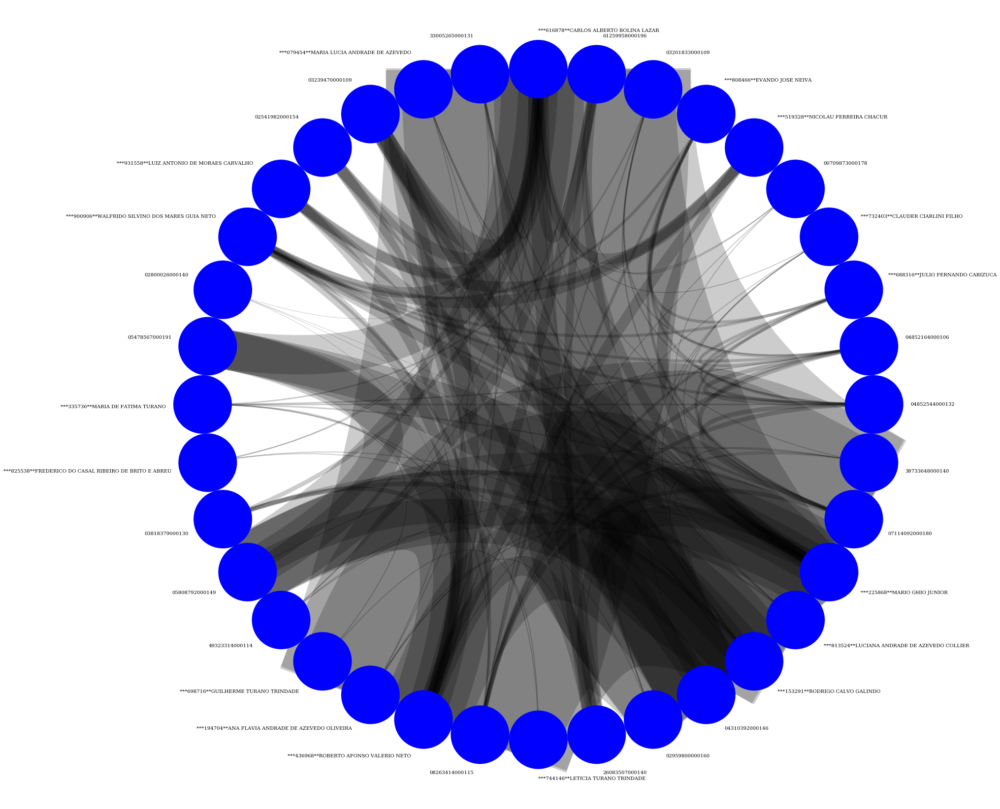

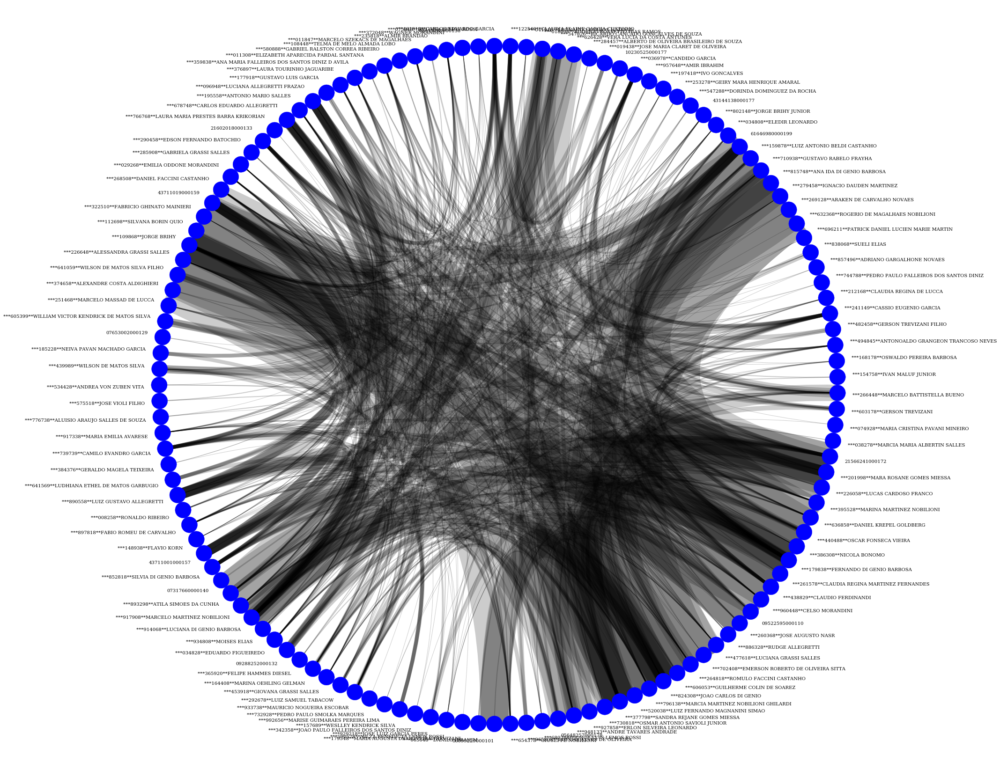

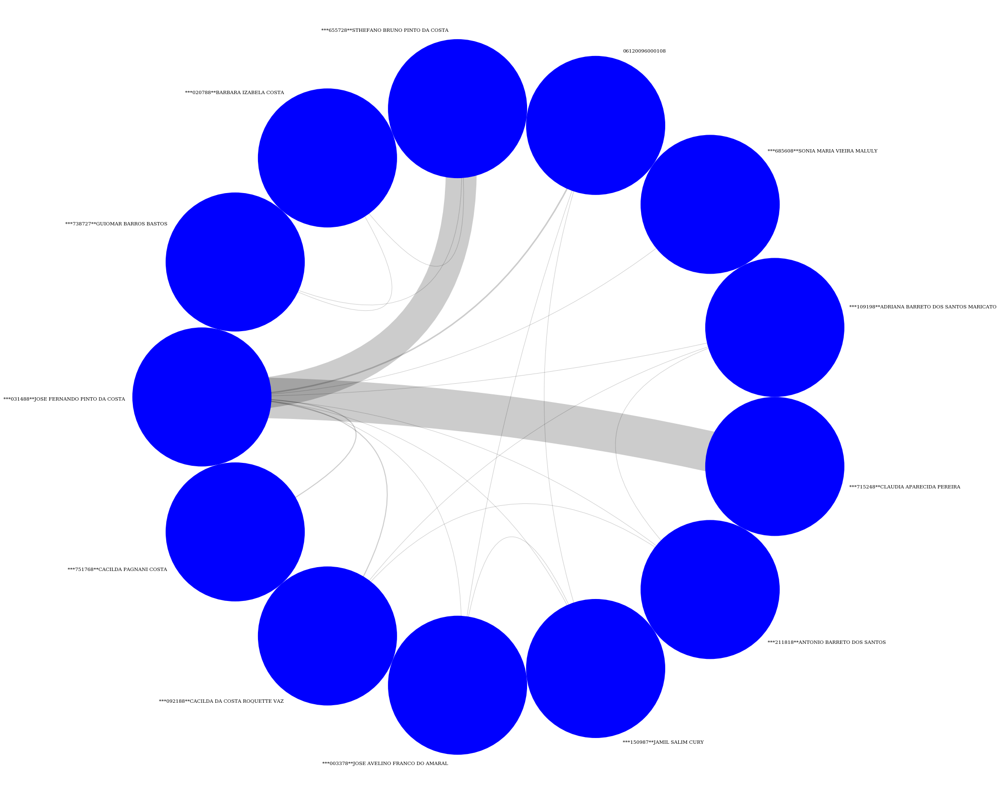

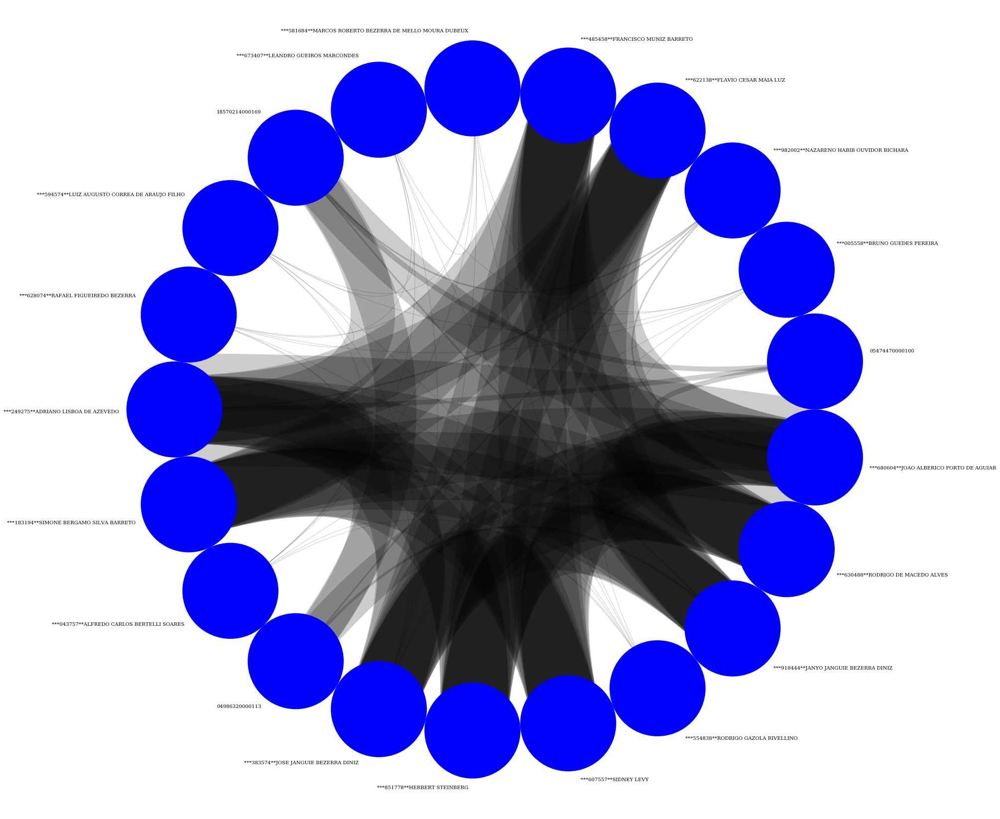

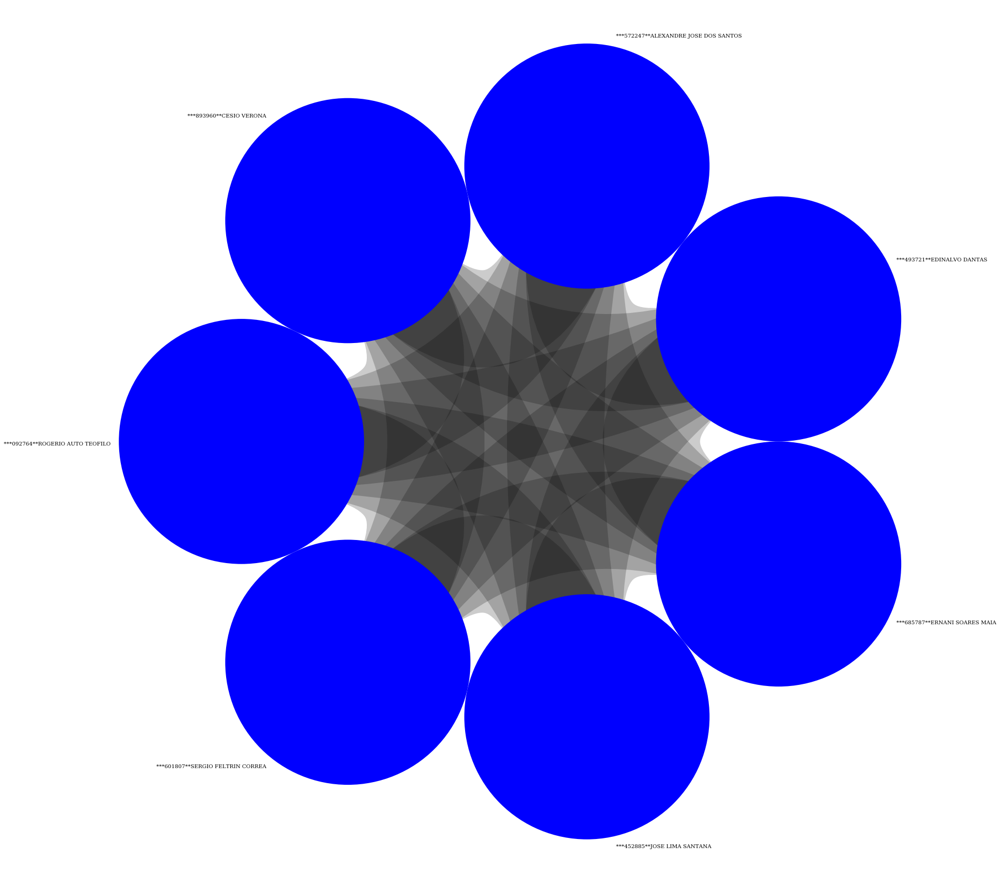

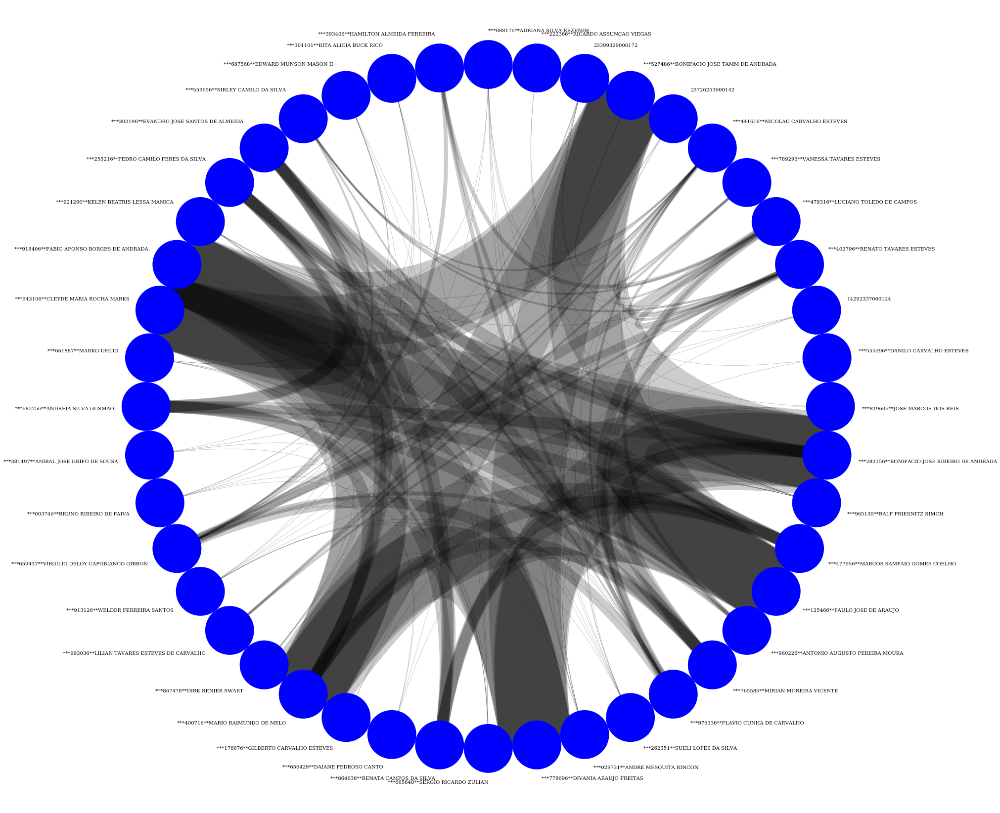

In [43]:
for key, G in barons_cc.items():
    c = CircosPlot(
        G,
        dpi=600,
    #     node_grouping="weight",
        edge_width="weight",
        figsize=(30, 30),
#         node_color="tipo_socio",
        node_labels=True,
    )
    c.draw()
    # plt.legend()
    plt.show()

In [119]:
def community_net(G_in):
    G_out = nx.Graph()
    node_color = []
    node_community = {}
    communities = nxcom.greedy_modularity_communities(G_in, weight='weight')
    for i, com in enumerate(communities):
        for v in com:
            G_out.add_node(v)
            G_out.nodes[v]['community'] = i
            node_color.append(i)
            node_community[v] = i
    G_out.add_edges_from(G_in.edges.data())
    return G_out

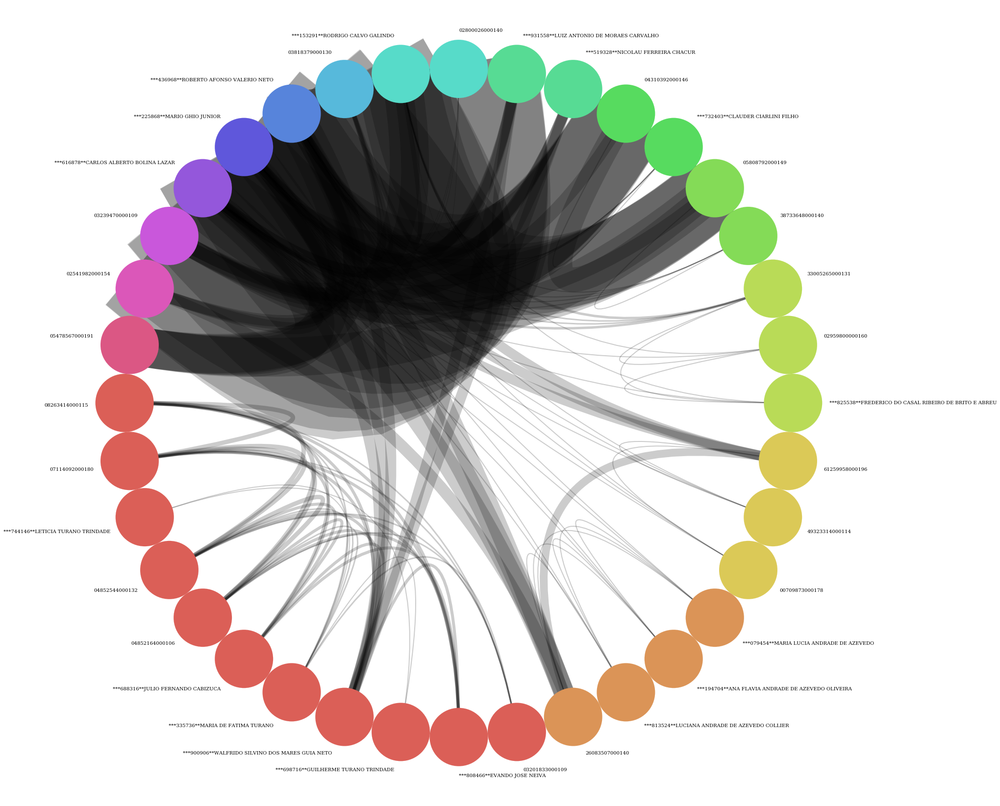

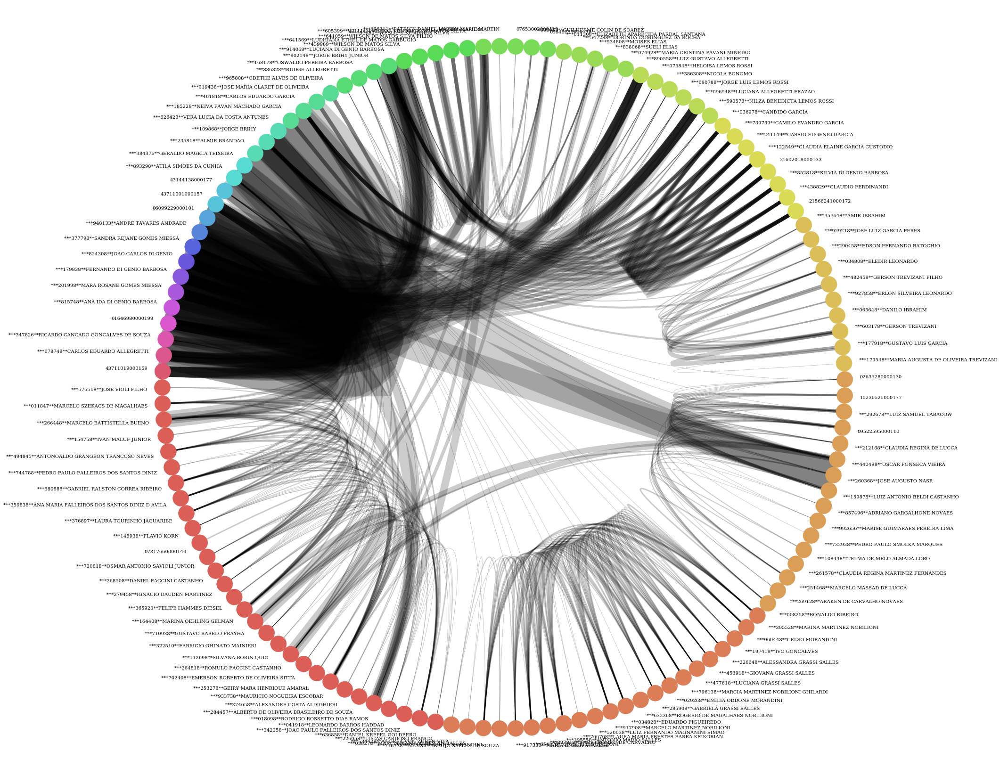

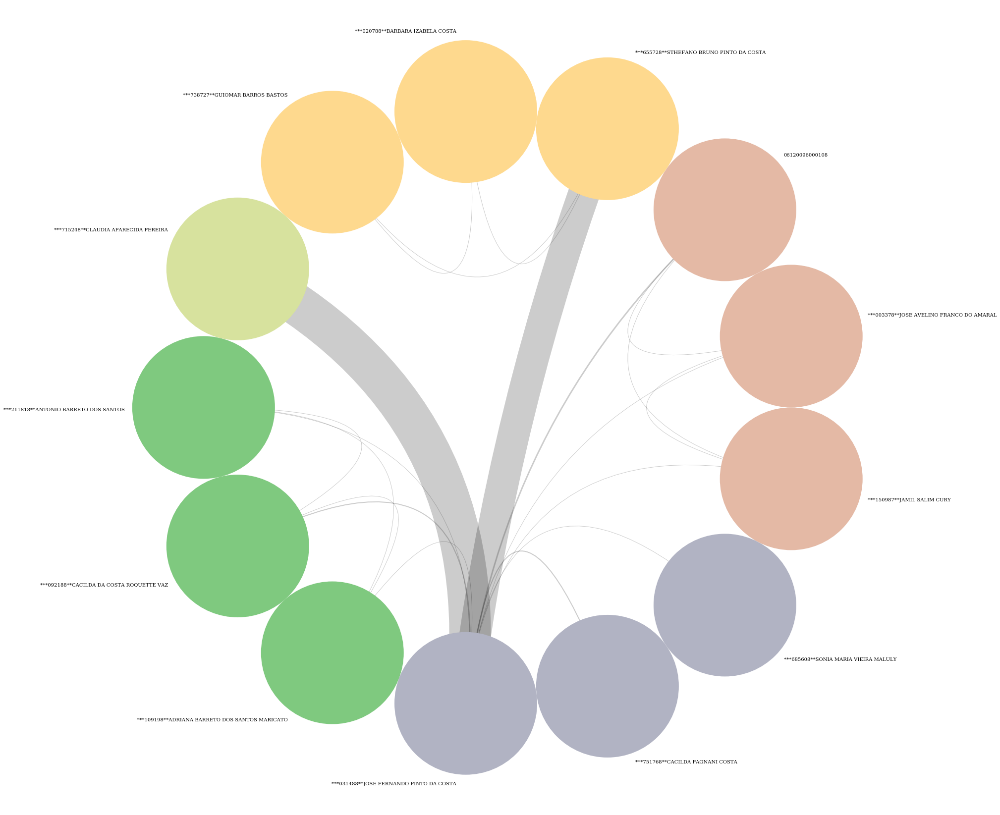

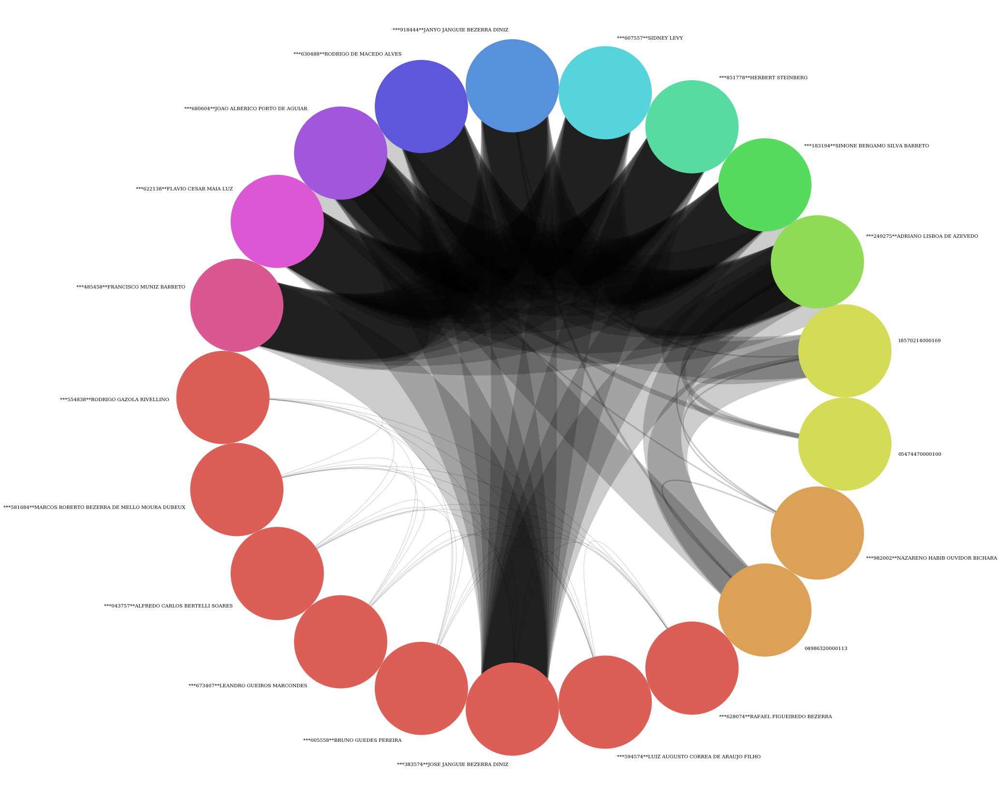

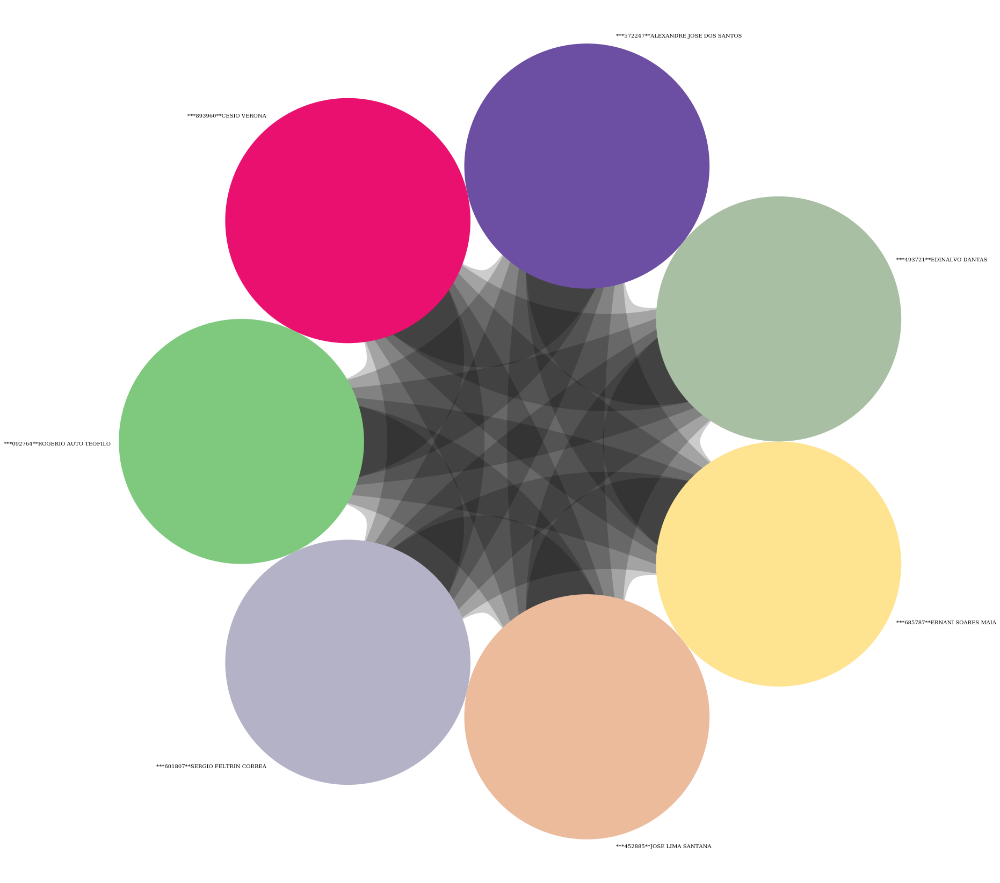

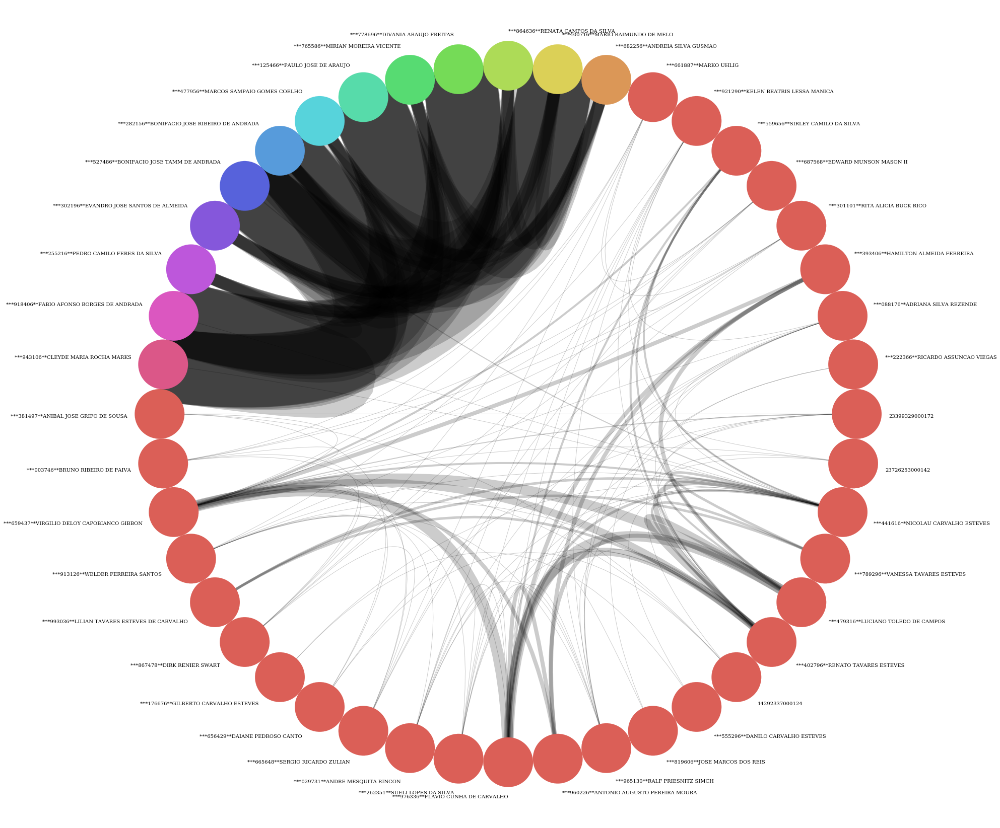

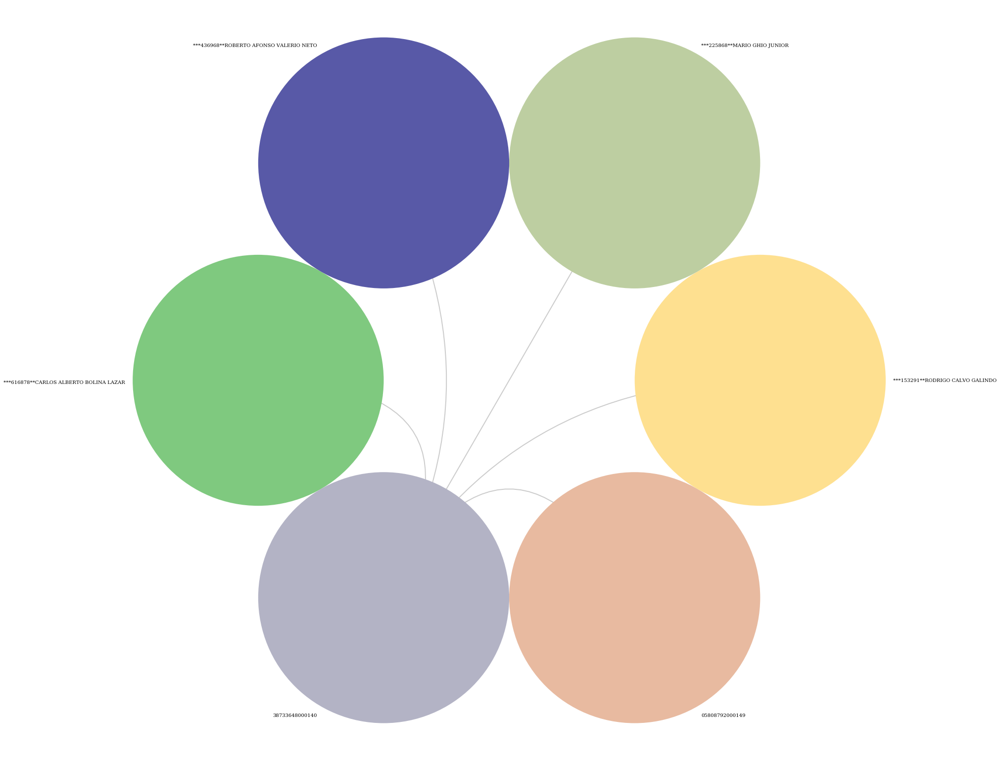

In [120]:
for key, G in barons_cc.items():
    c = CircosPlot(
        community_net(G),
        dpi=600,
    #     node_grouping="weight",
        edge_width="weight",
        figsize=(30, 30),
        node_color="community",
        node_labels=True,
    )
    c.draw()
    # plt.legend()
    plt.show()

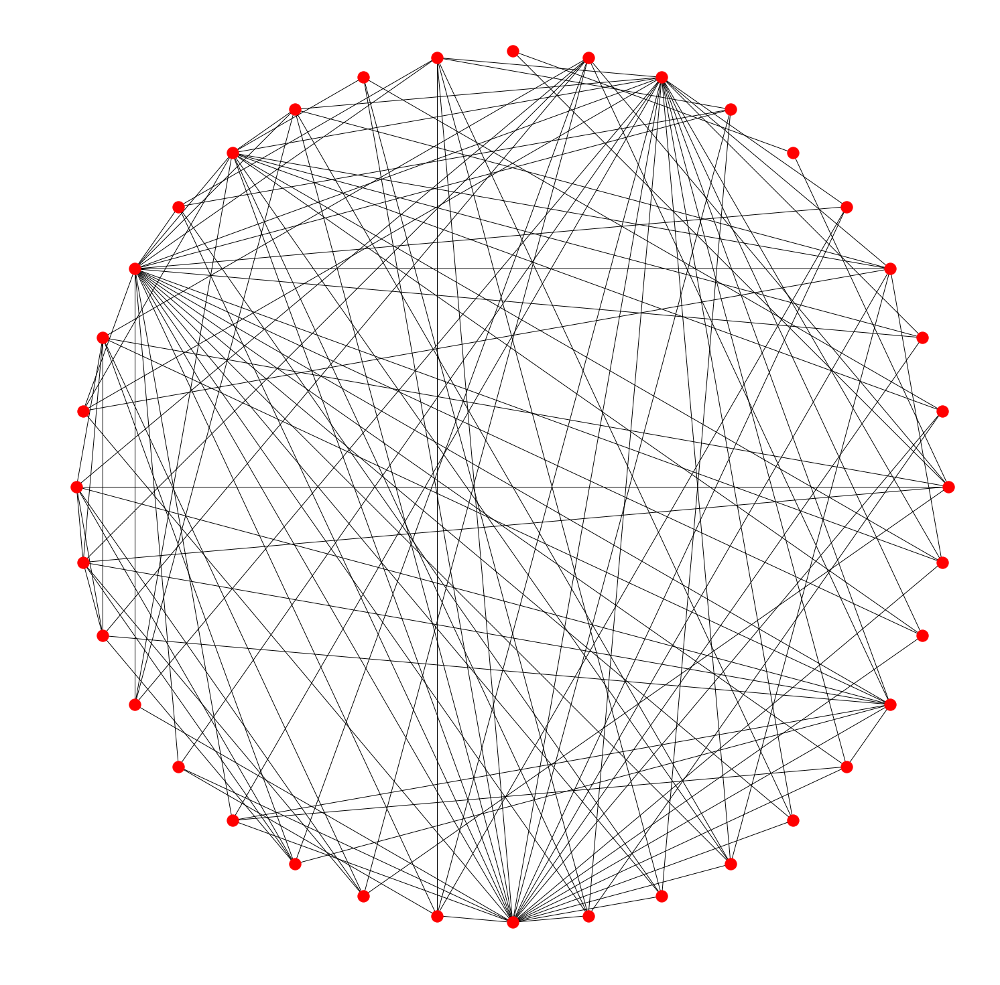

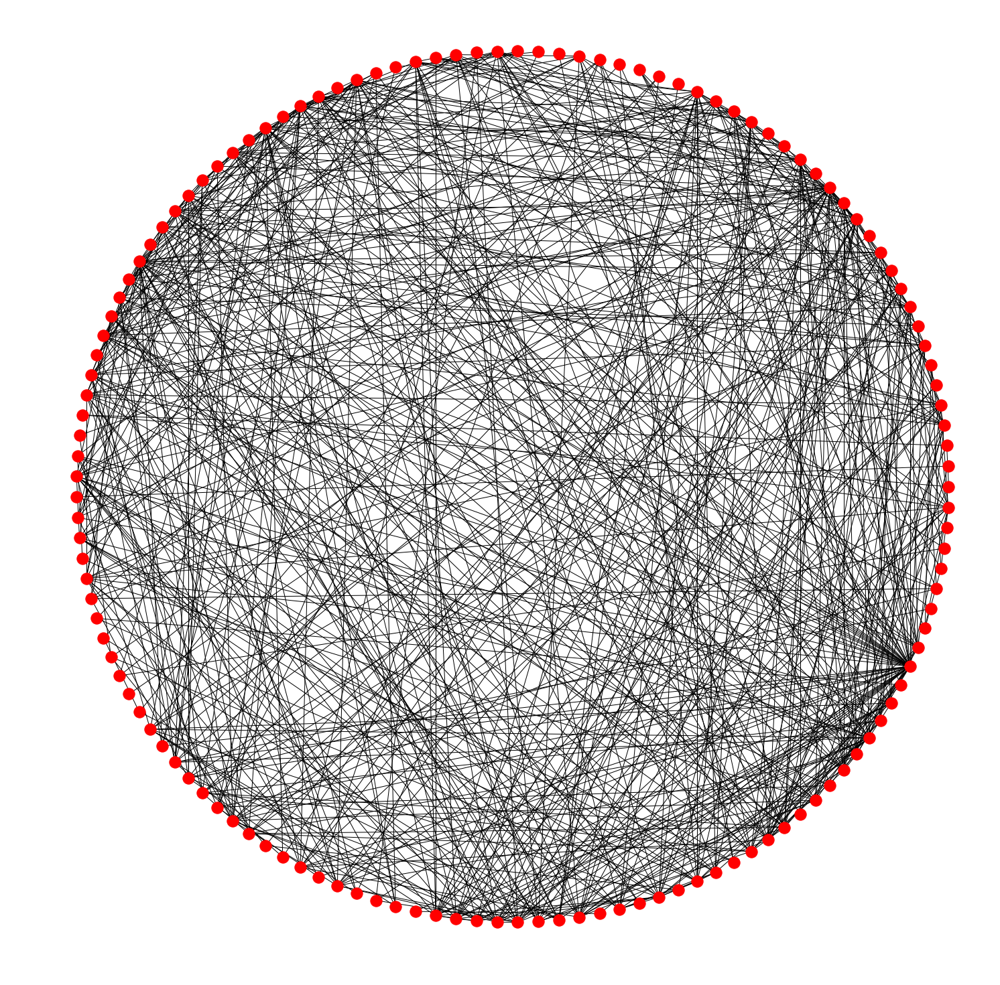

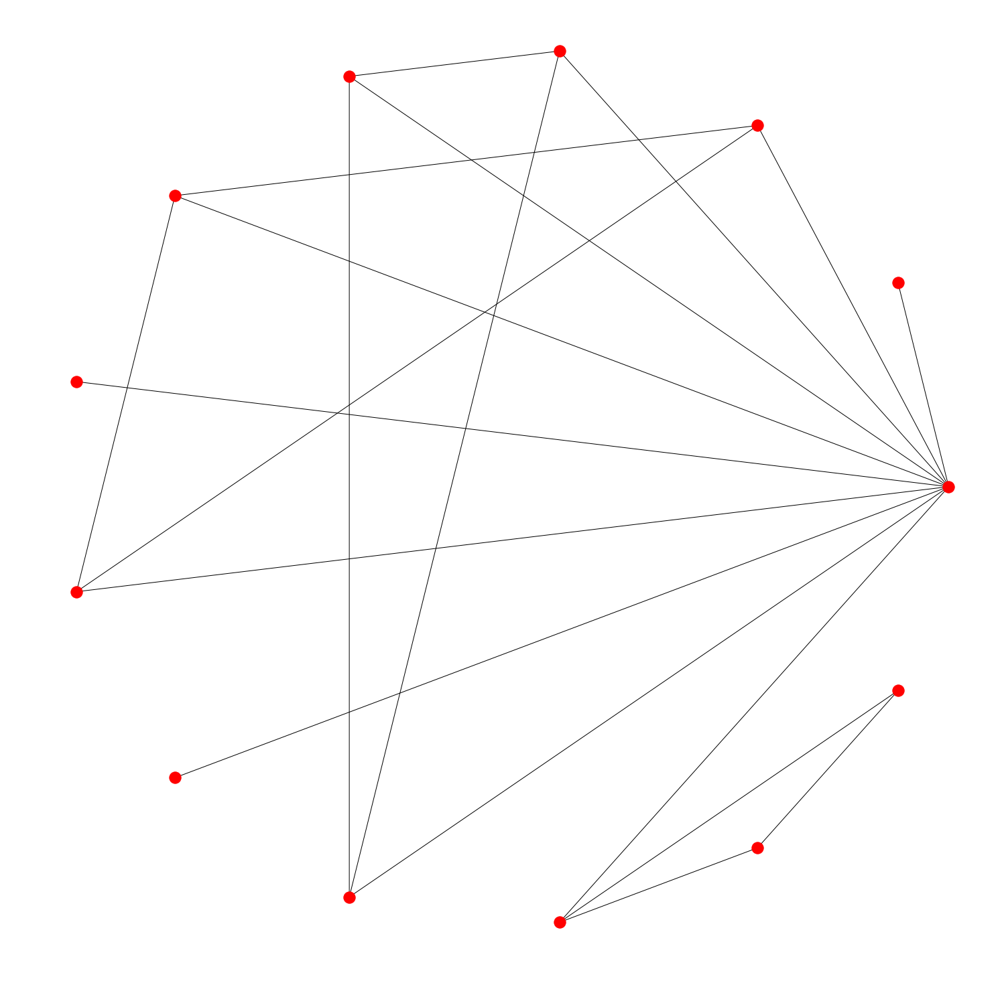

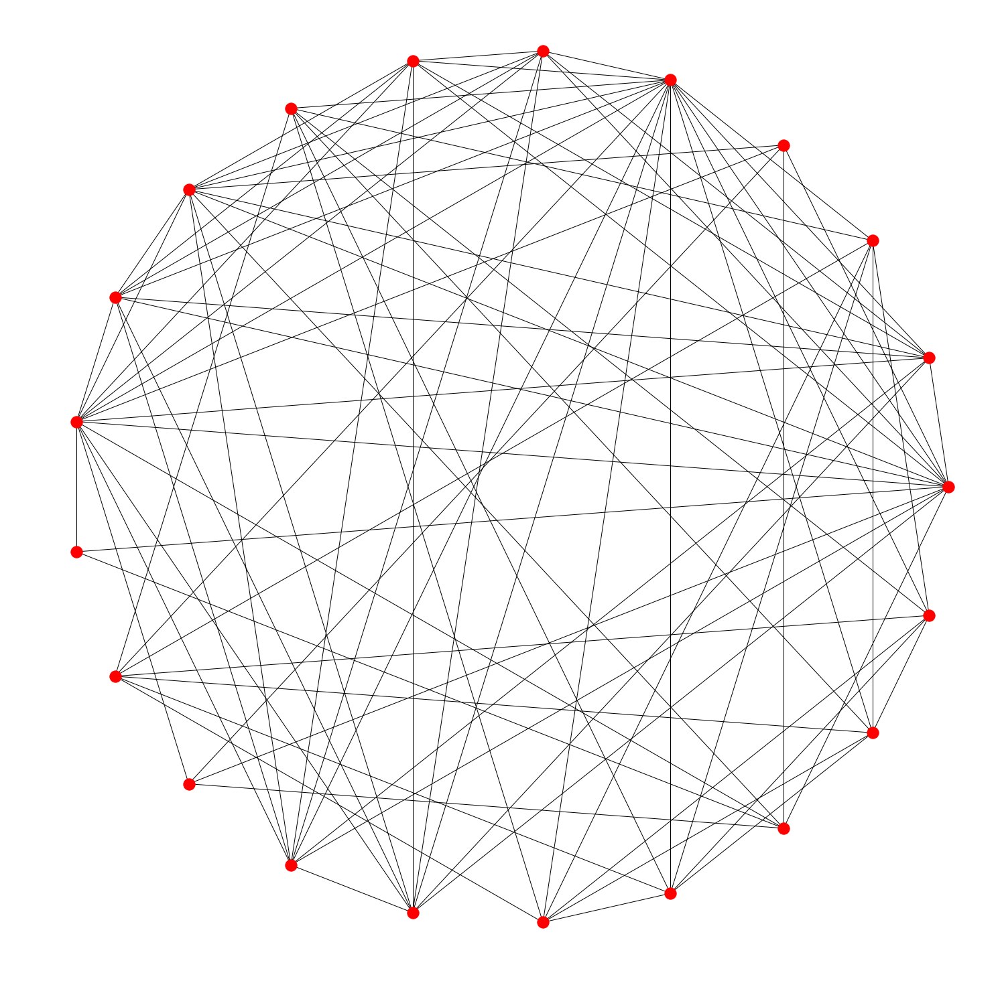

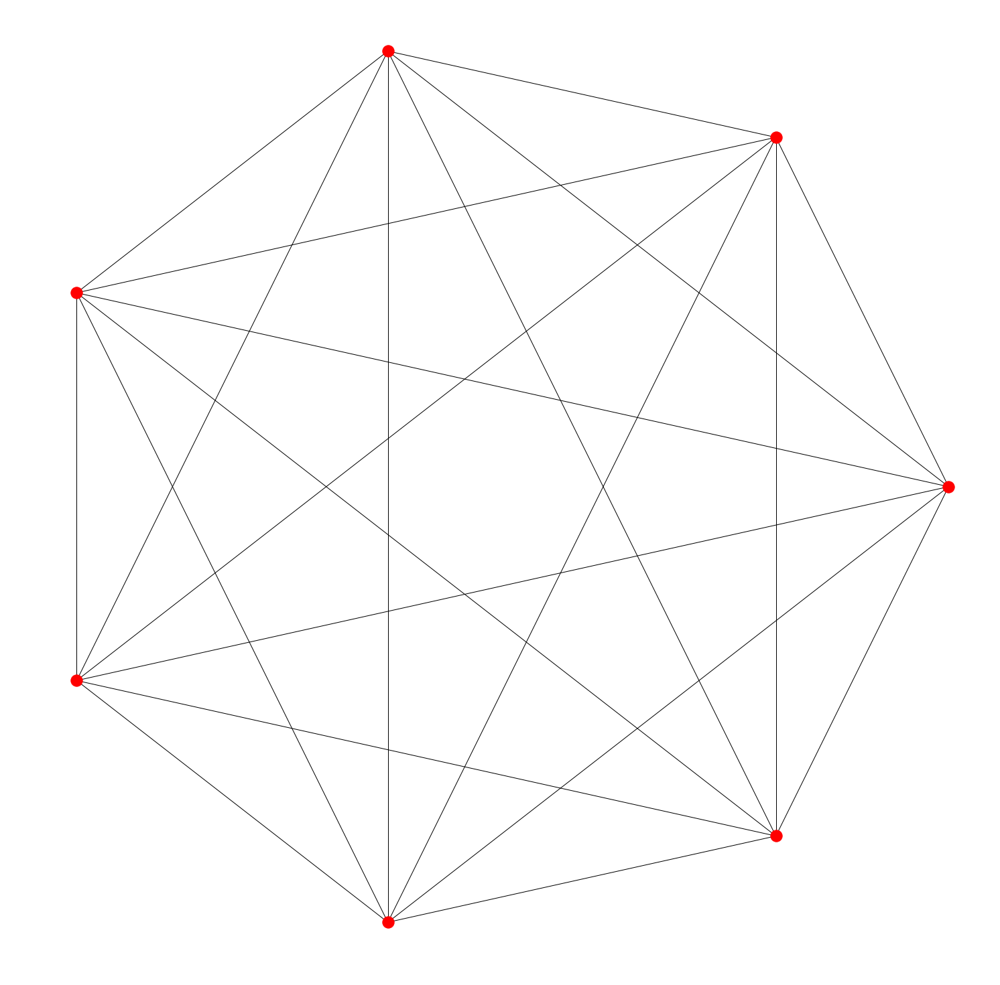

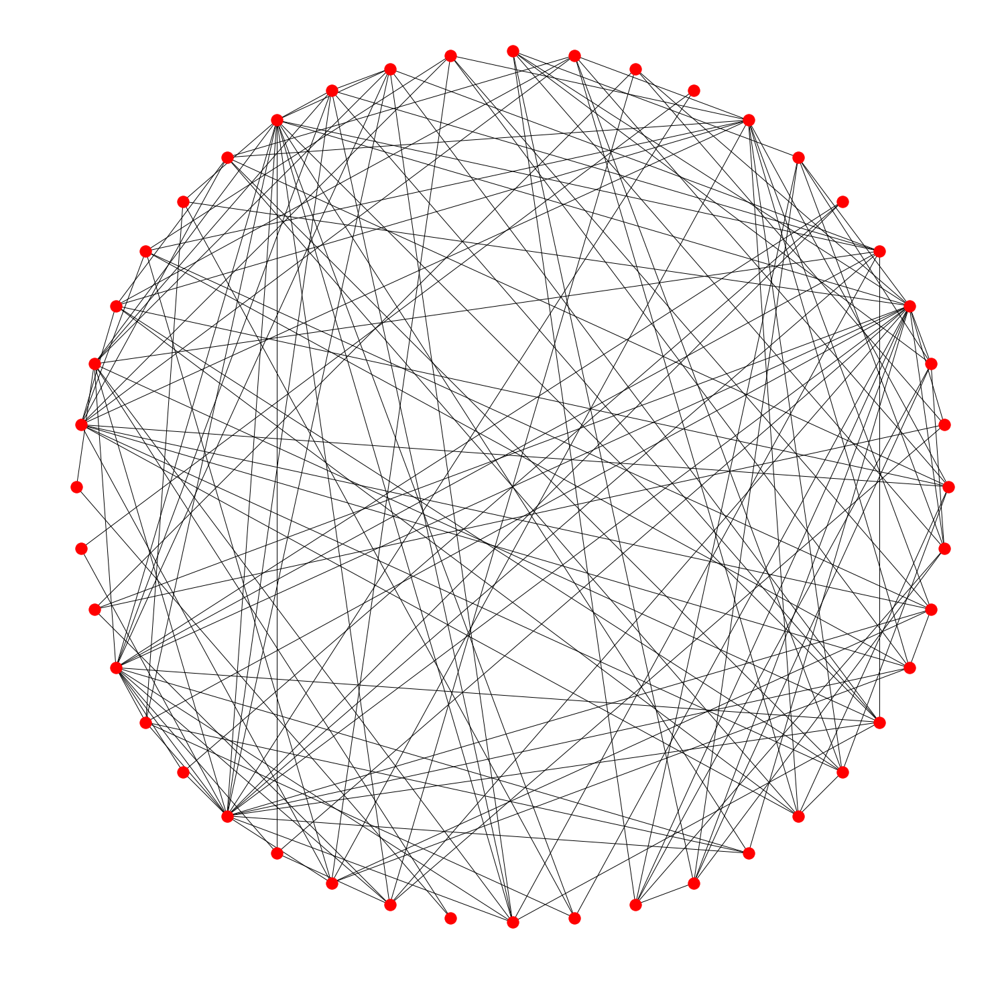

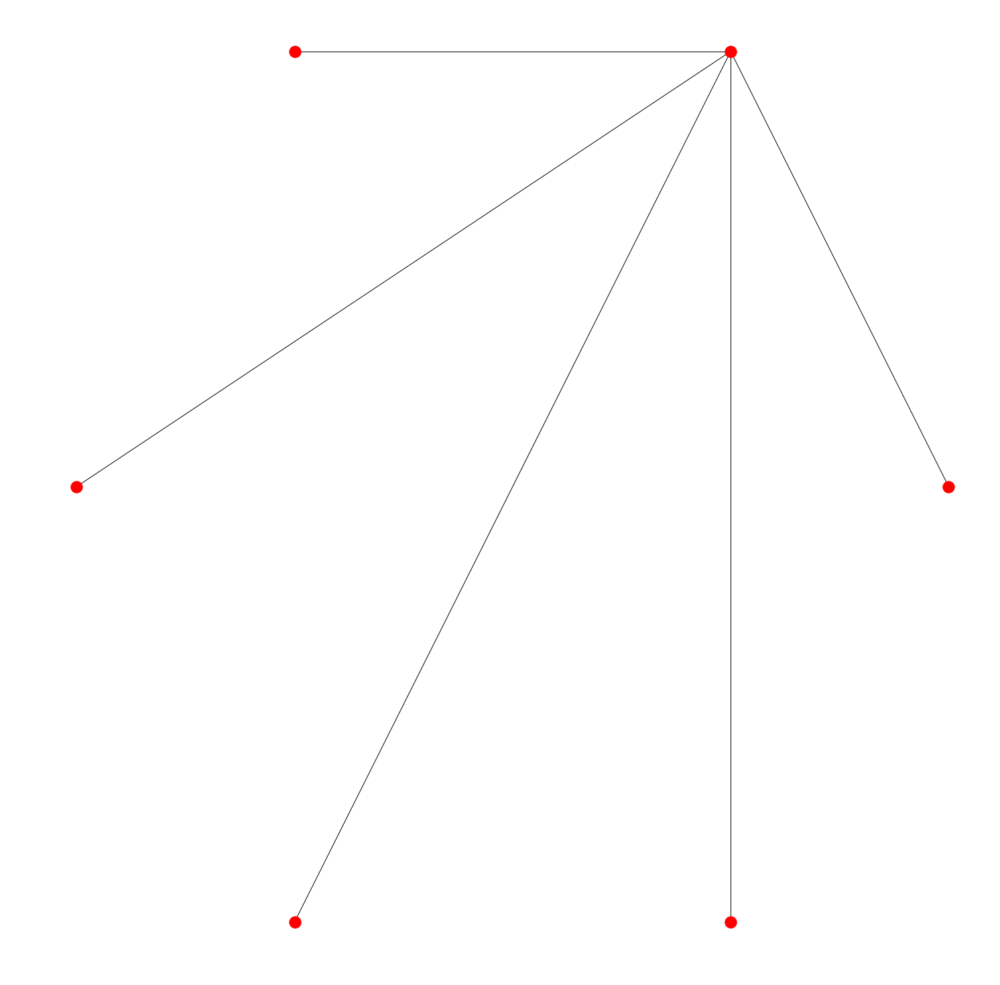

In [122]:
for key, G in barons_cc.items():
    plt.figure(figsize=(20,20))
    nx.draw_shell(G)
    plt.show()
#     c = CircosPlot(
#         G,
#         dpi=600,
#     #     node_grouping="weight",
#         edge_width="weight",
#         figsize=(30, 30),
# #         node_color="tipo_socio",
#         node_labels=True,
#     )
#     c.draw()
#     # plt.legend()
#     plt.show()

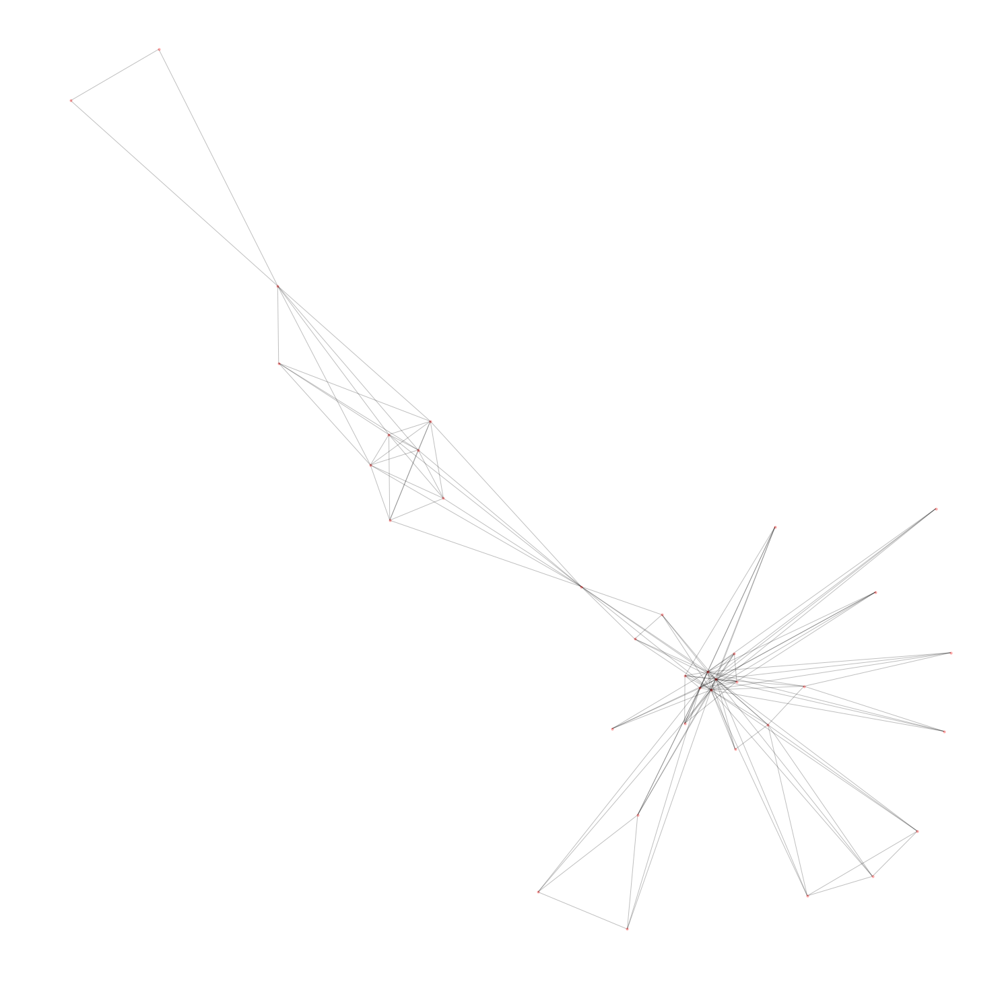

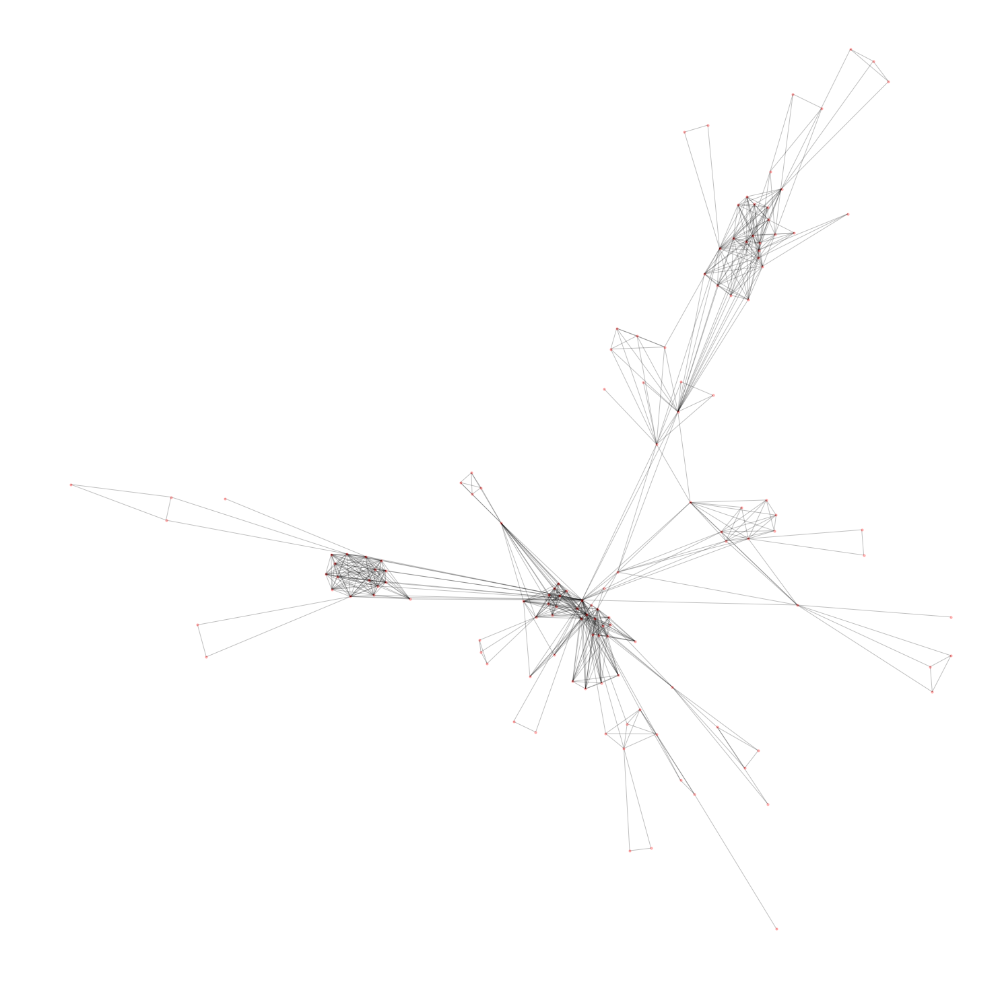

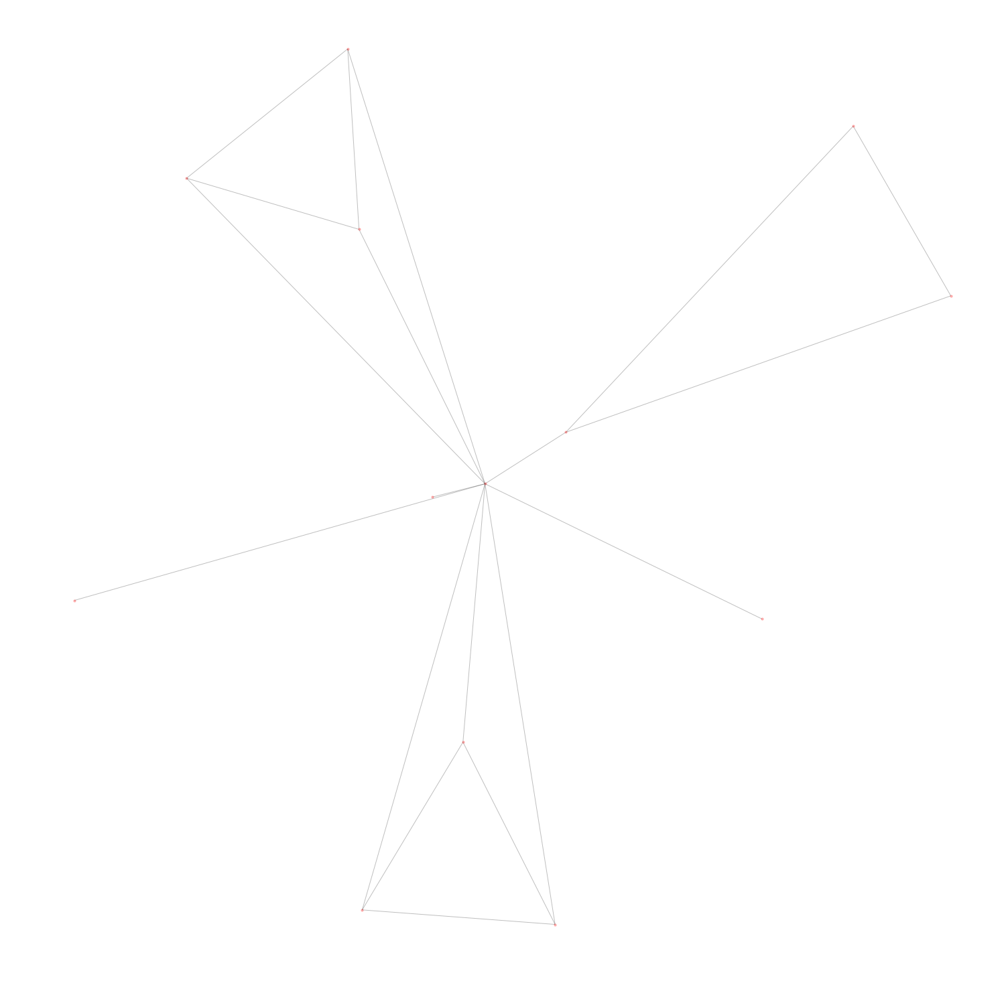

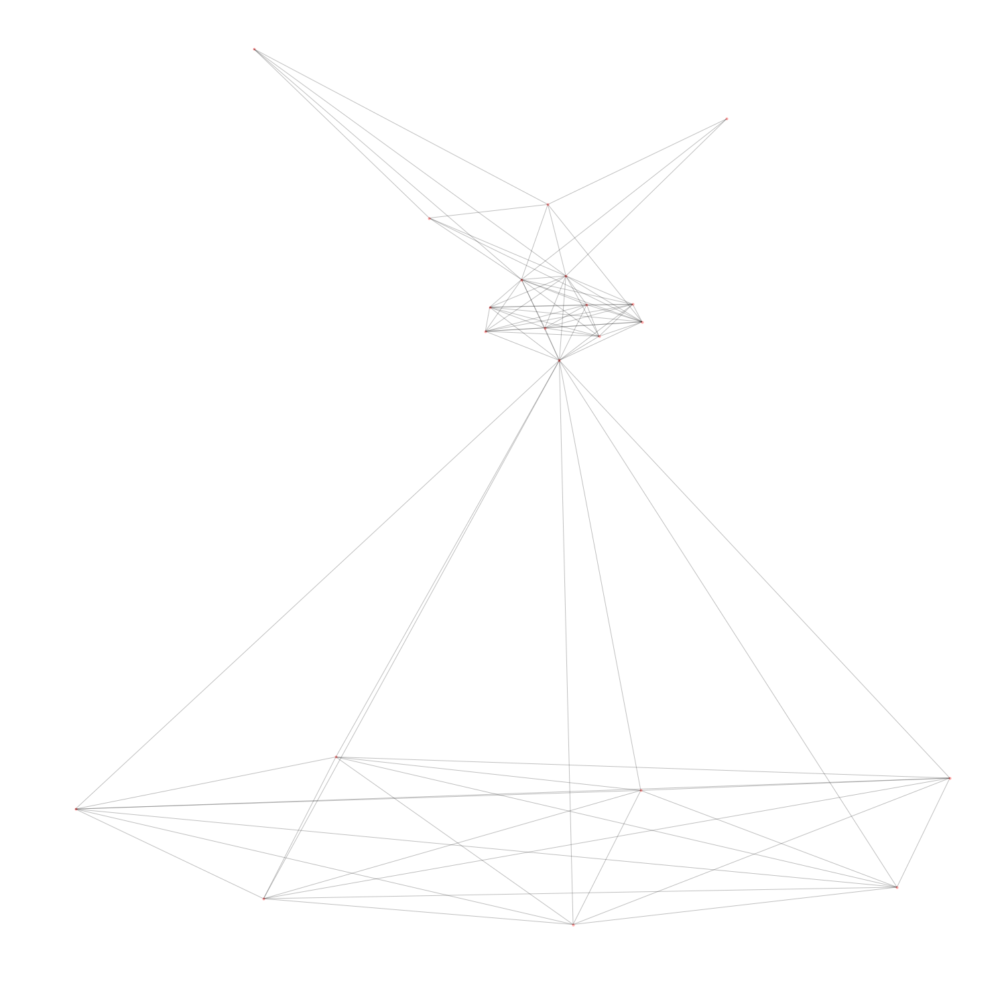

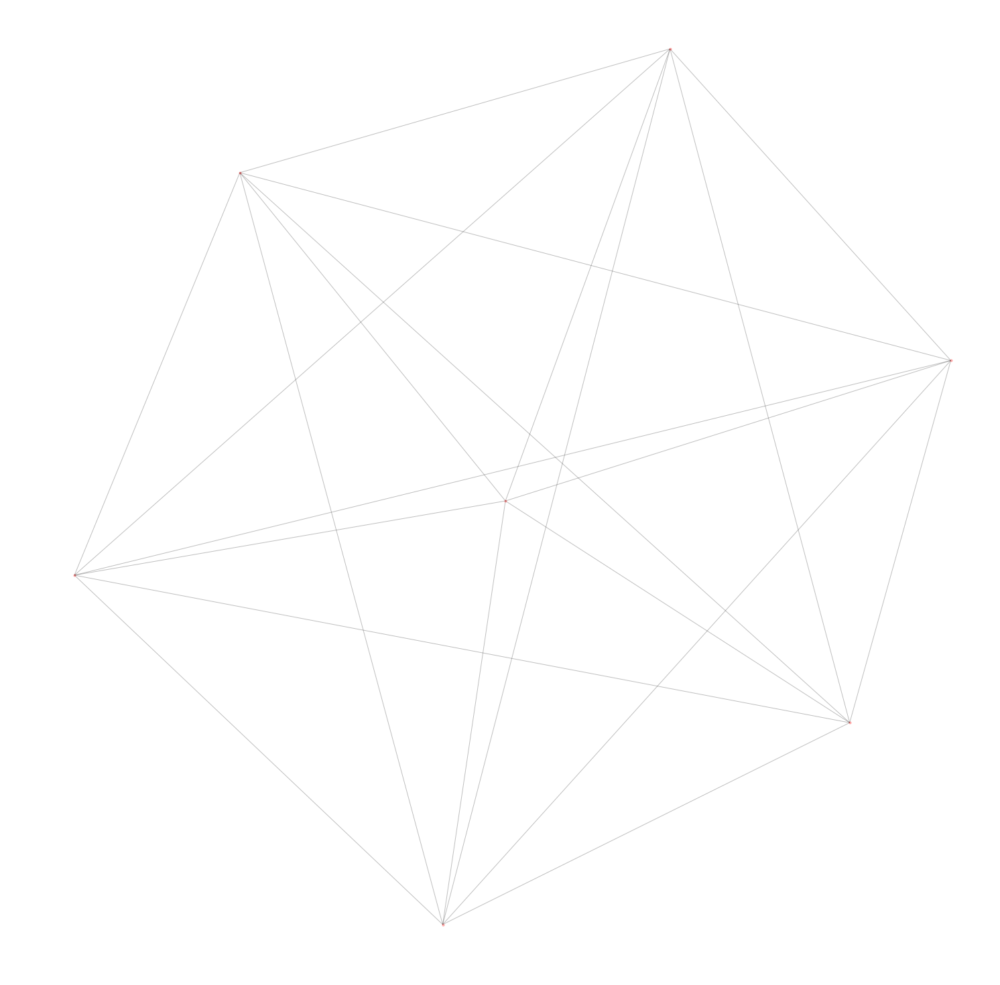

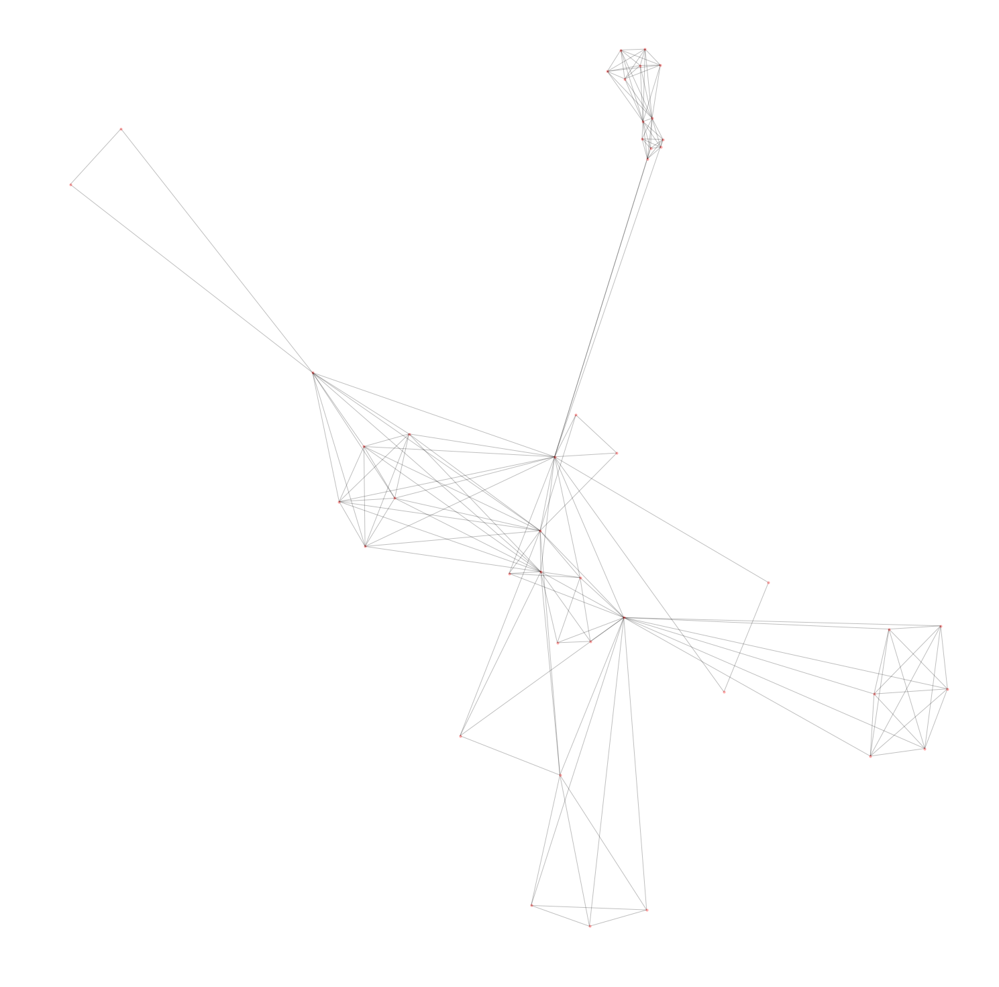

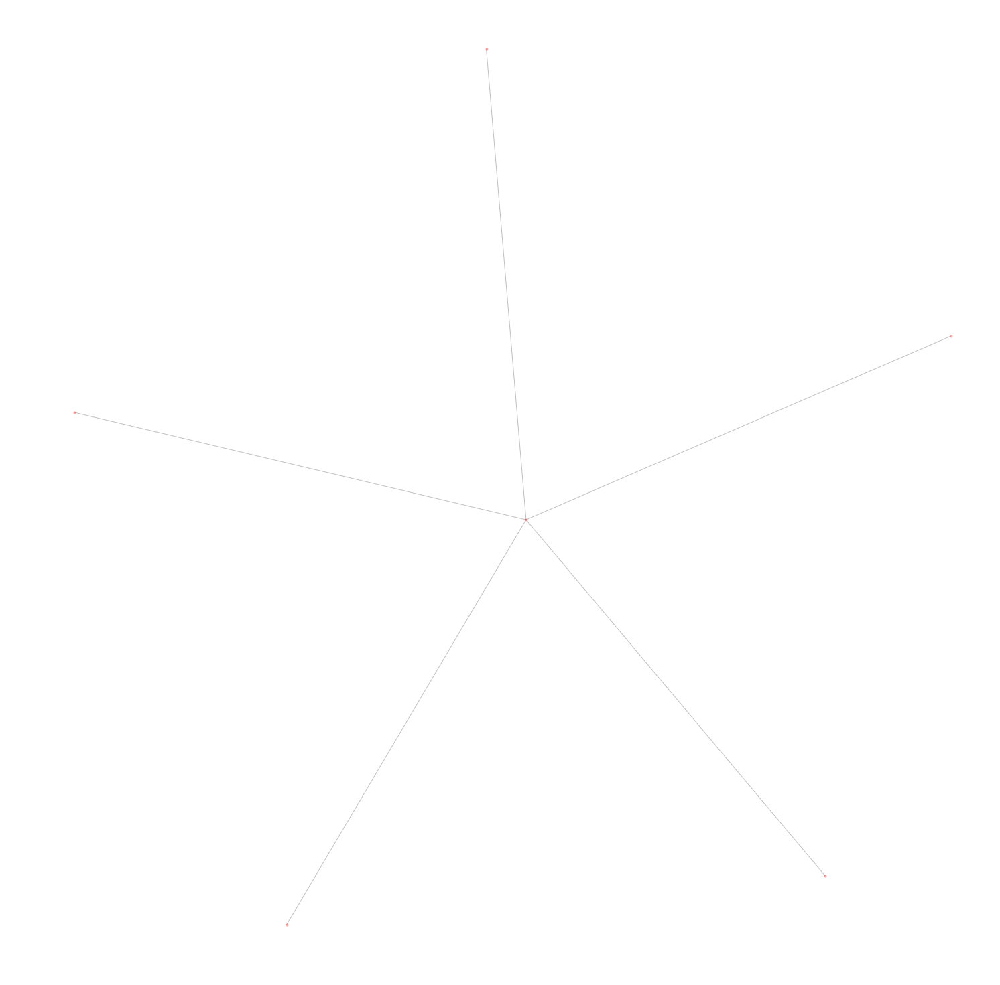

In [124]:
for key, G in barons_cc.items():
    plt.figure(figsize=(20,20))
    nx.draw(G, alpha=0.25, node_size=10)
    plt.show()

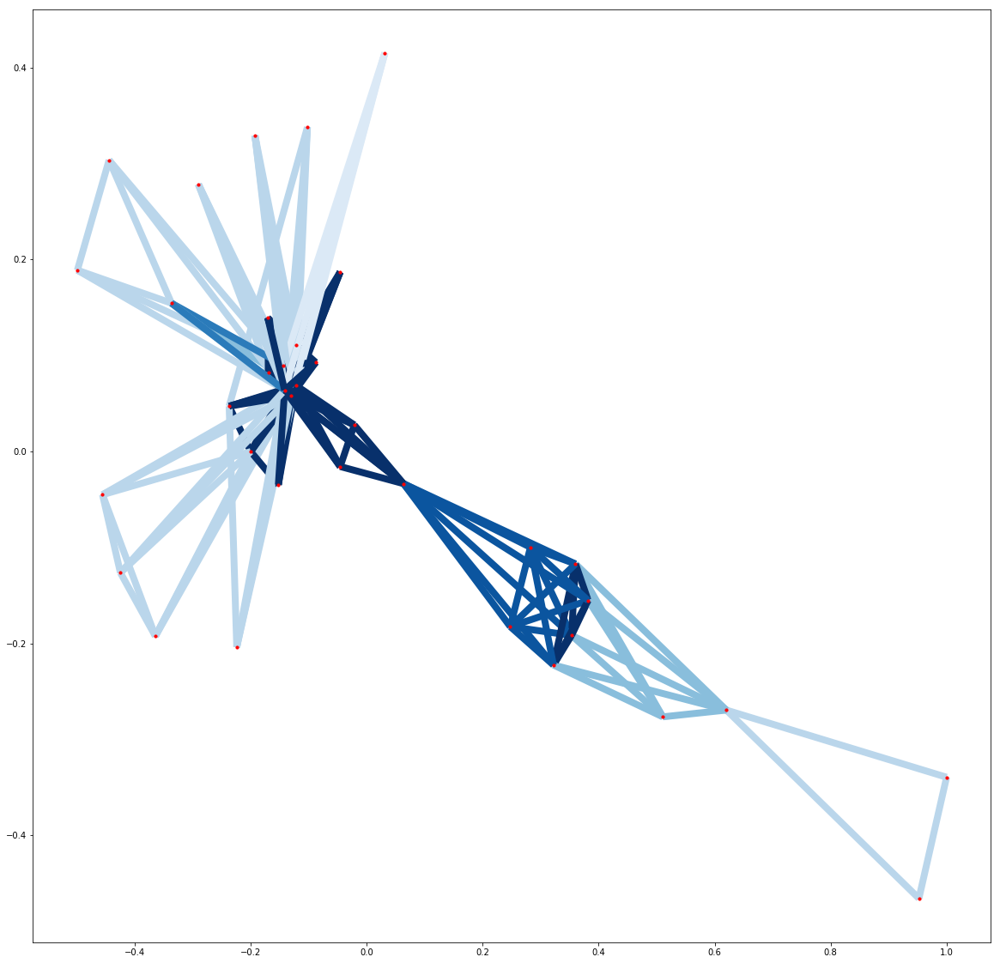

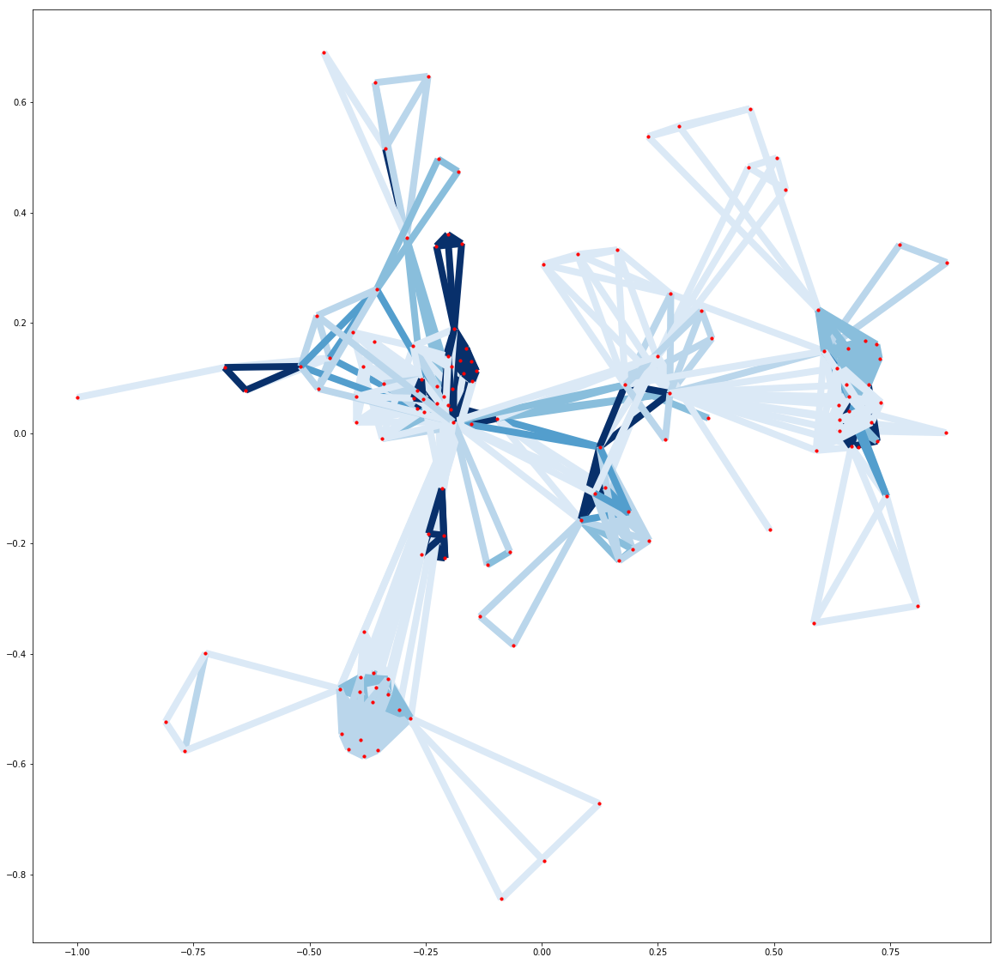

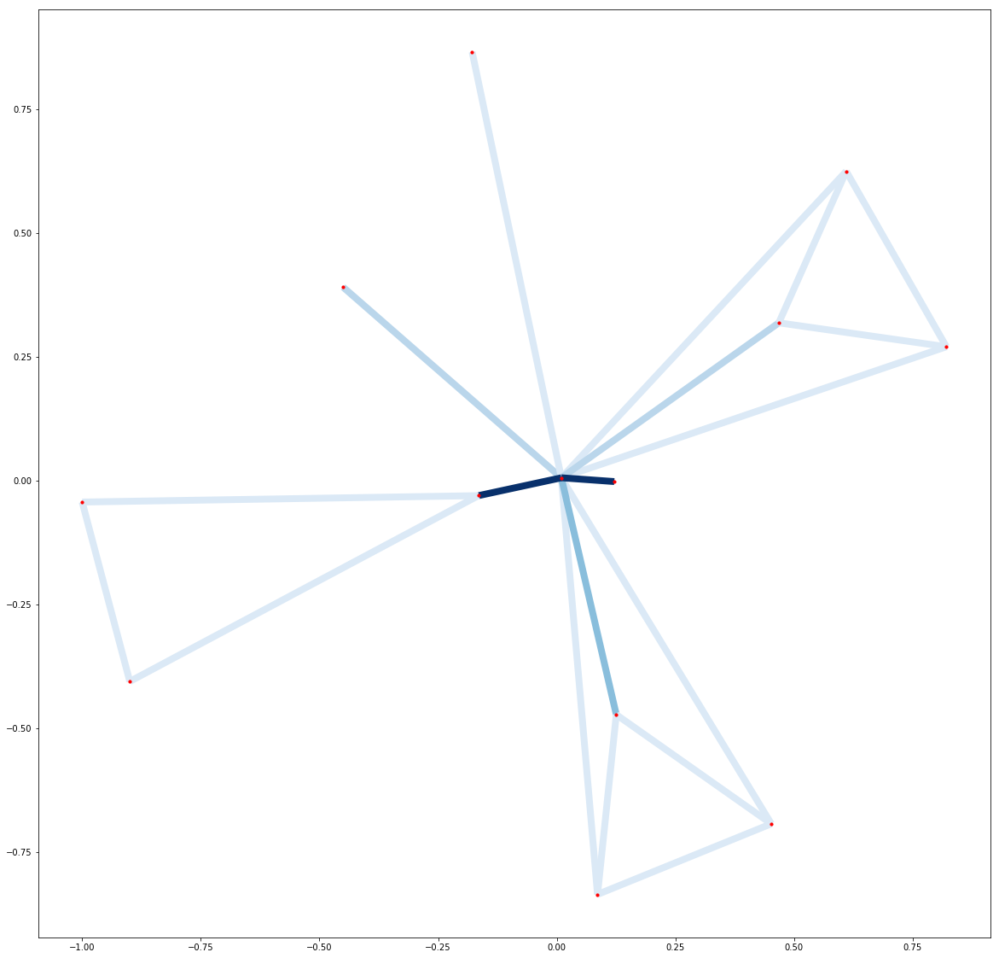

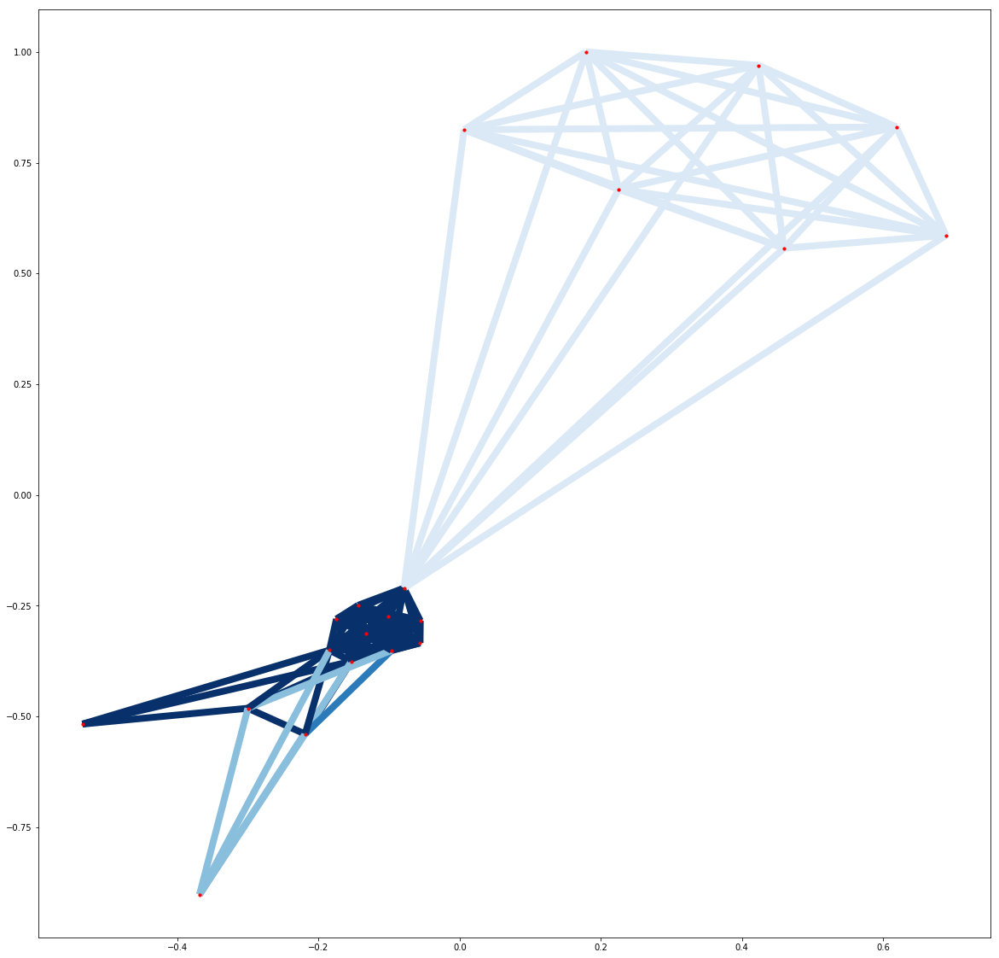

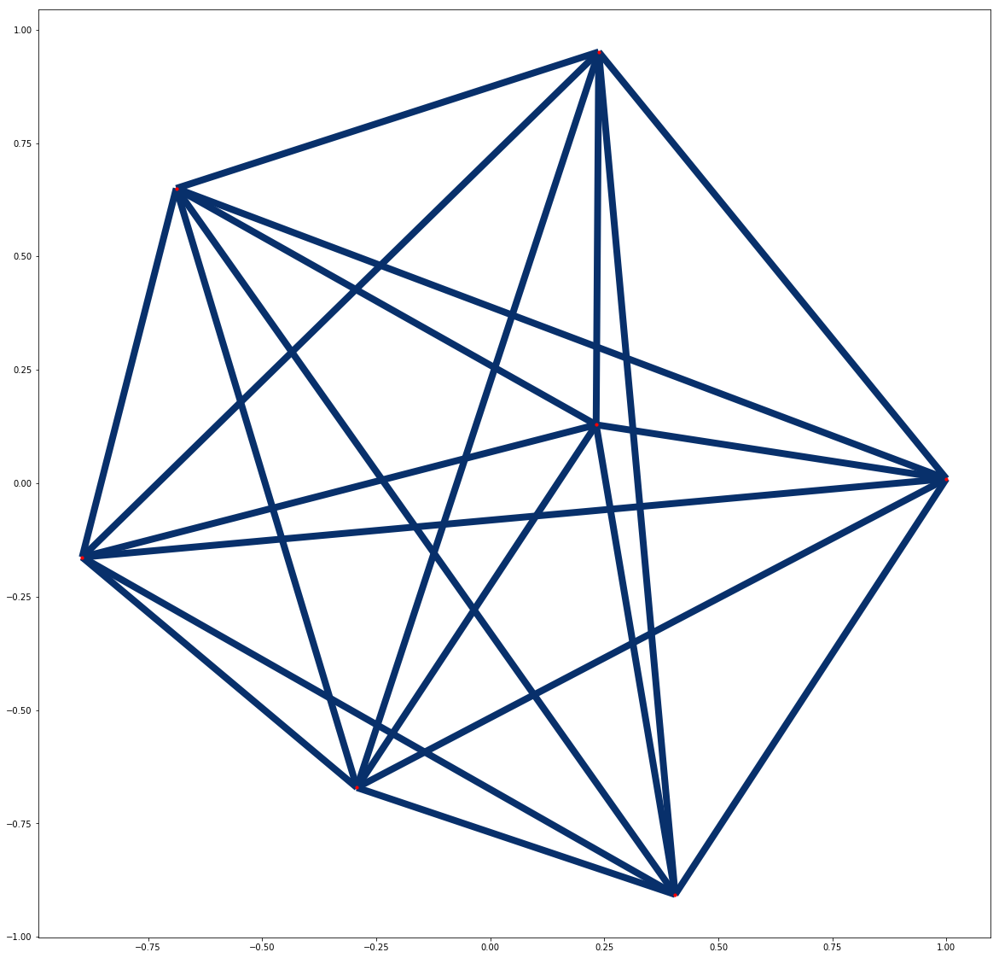

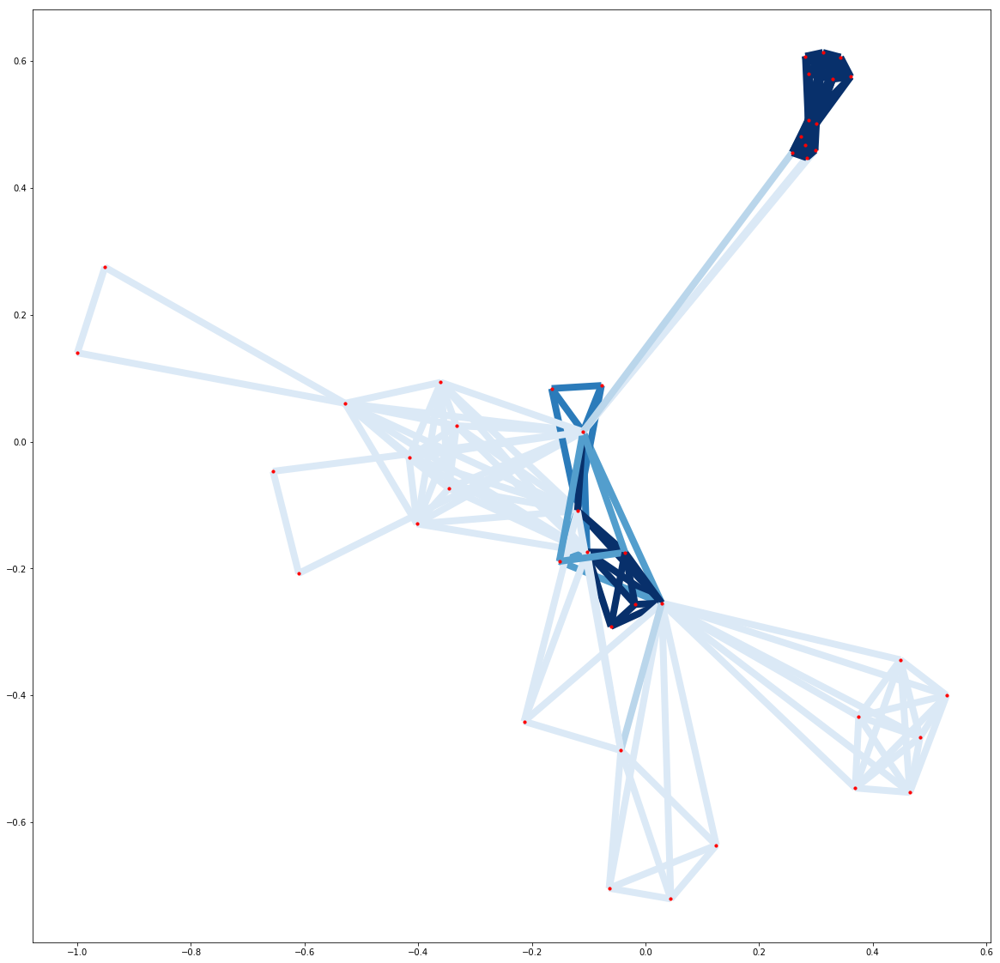

In [142]:
for key, G in barons_cc.items():
    plt.figure(figsize=(20,20))
    weighted_pos = nx.spring_layout(G, k=0.3, weight="weight")
    edge_weights = [G.edges[v, w]["weight"] for v, w in G.edges]
    nx.draw_networkx( 
        G, weighted_pos, width=8, edge_color=edge_weights, edge_cmap=plt.cm.Blues,
    edge_vmin=0, edge_vmax=7, with_labels=False, node_size=10)
    plt.show()

# Draw solid/dashed lines on top of internal/external edges 
# nx.draw_networkx_edges(
#     G, weighted_pos, edgelist=internal, edge_color="gray") 
# nx.draw_networkx_edges(
#     G, weighted_pos, edgelist=external, edge_color="gray", style="dashed")

In [135]:
barons_cc.pop('38733648000140')

## Métricas Globais dos Grafos

In [44]:
import collections

In [63]:
def plot_deegree_hist(G, bins, low_limit=0):
    degree_sequence = sorted([d for n, d in G.degree() if d > low_limit], reverse=True)  # degree sequence
    # print "Degree sequence", degree_sequence
#     degreeCount = collections.Counter(degree_sequence)
#     deg, cnt = zip(*degreeCount.items())
    plt.figure(figsize=(16, 8))
    plt.hist(degree_sequence, bins=bins, density=True, alpha=0.5,
         histtype='stepfilled', color='steelblue',
         edgecolor='none')
#     fig, ax = plt.subplots()
#     plt.bar(deg, cnt, width=0.80, color='b')

    plt.title("Degree Histogram")
    plt.ylabel("Count")
    plt.xlabel("Degree")
#     ax.set_xticks([d + 0.4 for d in deg])
#     ax.set_xticklabels(deg)

    plt.show()

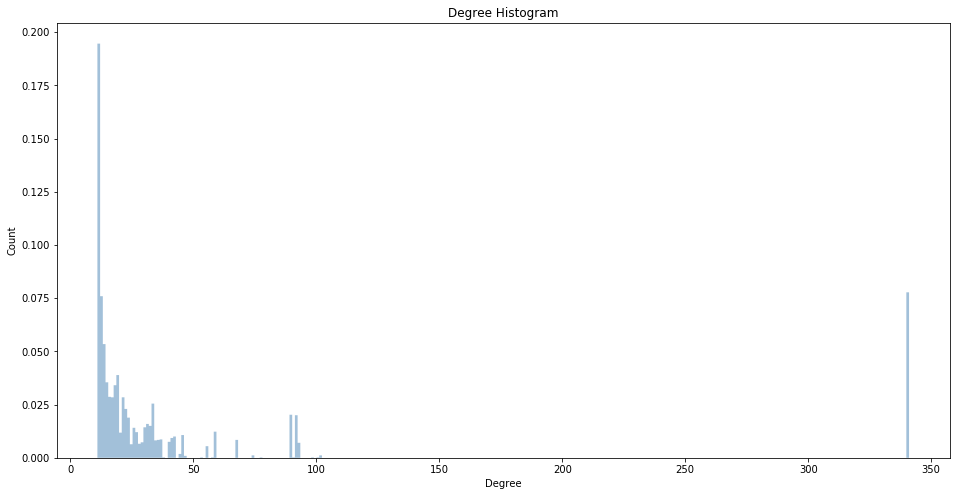

In [65]:
plot_deegree_hist(G_SOC, 300,low_limit=10)

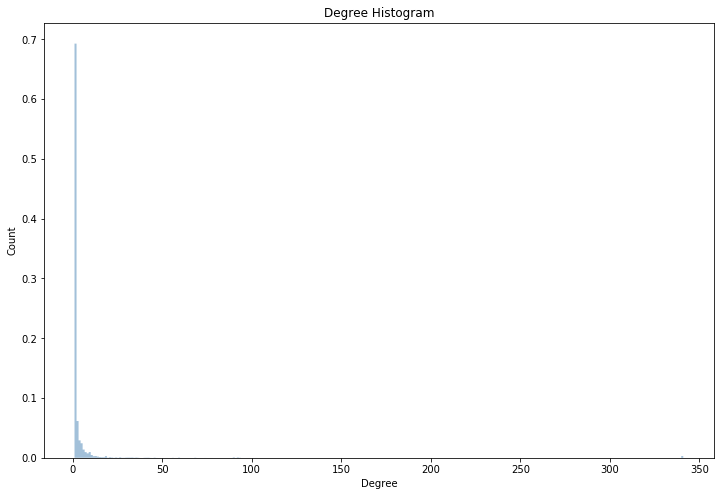

In [46]:
plot_deegree_hist(G_SOC)

In [47]:
len(nx.degree_histogram(G_SOC))

342

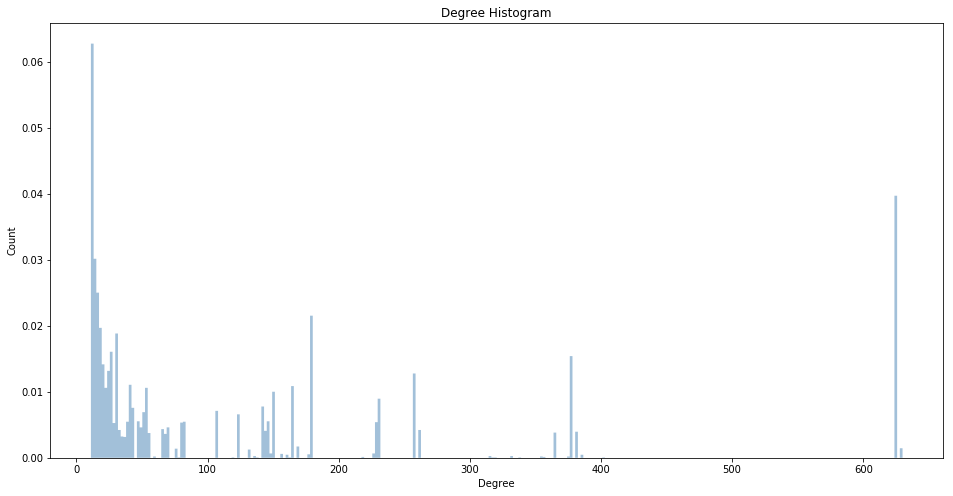

In [58]:
plot_deegree_hist(G_EMP, low_limit=10)

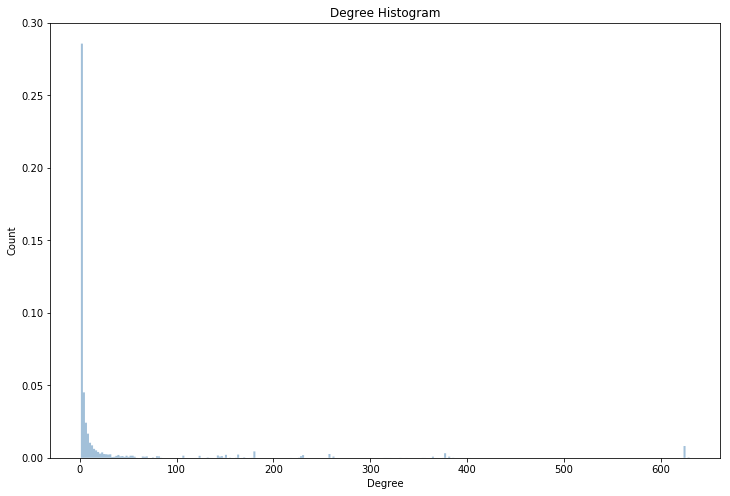

In [48]:
plot_deegree_hist(G_EMP)

In [68]:
len(nx.degree_histogram(G_EMP))

631

In [110]:
avg_clust = {}
for k, G in graphs.items():
    print(key, "Largest CC")
    avg_clust[key] = nx.average_clustering(G.subgraph(largest_cc[key]))
    print(avg_clust[key])
    print("---")

Empresas Largest CC


ZeroDivisionError: division by zero

In [111]:
nx.average_clustering(G_SOC.subgraph(largest_cc[SOCIOS]))

1.0

In [112]:
nx.average_shortest_path_length(G_SOC.subgraph(largest_cc[SOCIOS]))

1.0

In [113]:
nx.density(G_SOC.subgraph(largest_cc[SOCIOS]))

1.0

In [114]:
print_info(G_SOC.subgraph(largest_cc[SOCIOS]))

Name: 
Type: Graph
Number of nodes: 342
Number of edges: 58311
Average degree: 341.0000
Nós isolados: 0
É bipartido: False
Número de arestas de um nó para si mesmo: 0


In [120]:
G_EMP['59527788000131']

AtlasView({'59527788001880': {'weight': 342}, '59527788001103': {'weight': 342}, '59527788000484': {'weight': 342}, '59527788000212': {'weight': 342}, '59527788001537': {'weight': 342}, '59527788001456': {'weight': 342}, '59527788000565': {'weight': 342}, '59527788000646': {'weight': 342}})

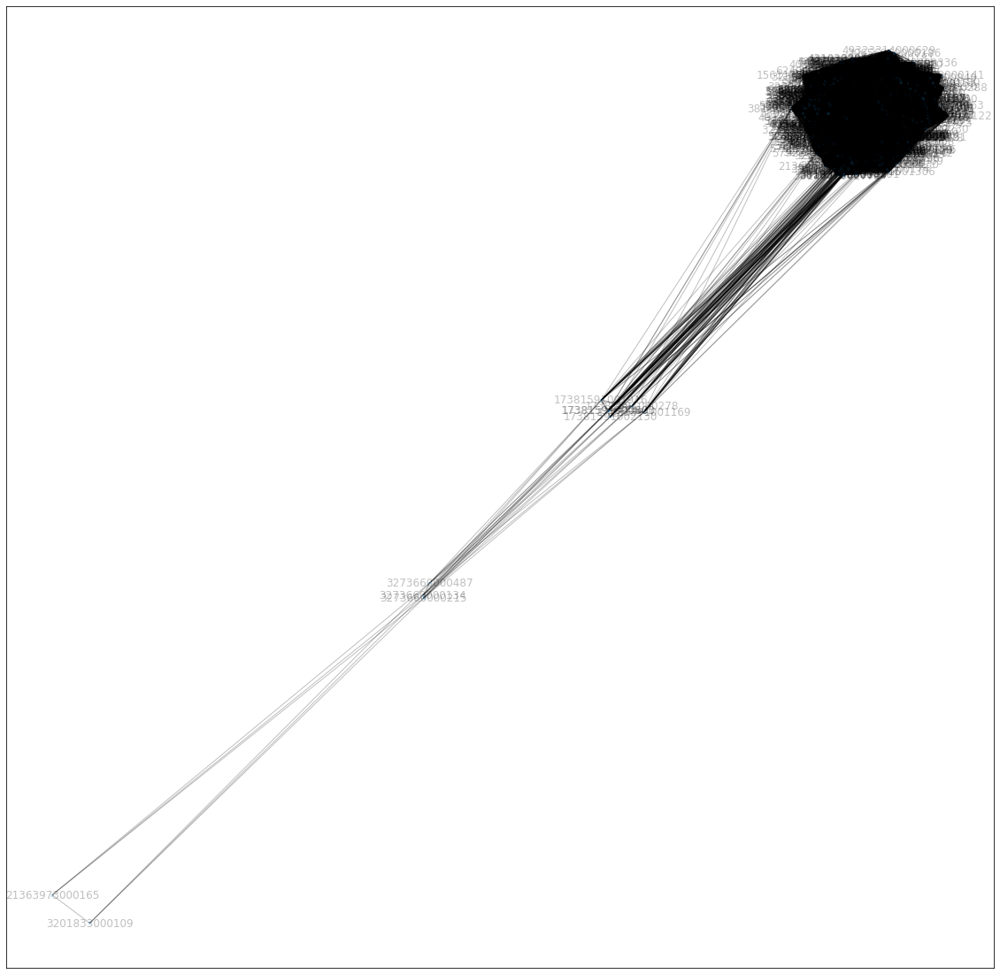

In [119]:
plt.figure(figsize=(20,20))
nx.draw_networkx(G_EMP.subgraph(largest_cc[EMPRESAS]), alpha=0.25, node_size=5)

In [115]:
import networkx.algorithms.community as nxcom

def community_net(G_in):
    G_out = nx.Graph()
    node_color = []
    node_community = {}
    communities = nxcom.greedy_modularity_communities(G_in, weight='weight')
    for i, com in enumerate(communities):
        for v in com:
            G_out.add_node(v)
            G_out.nodes[v]['community'] = i
            node_color.append(i)
            node_community[v] = i
    G_out.add_edges_from(G_in.edges.data())
    return node_color, node_community, G_out

In [114]:
list(barons_cc['***616878**CARLOS ALBERTO BOLINA LAZAR'].edges.data())

[('***335736**MARIA DE FATIMA TURANO',
  '***744146**LETICIA TURANO TRINDADE',
  {'id': '24472', 'weight': 2.0}),
 ('***335736**MARIA DE FATIMA TURANO',
  '08263414000115',
  {'id': '24474', 'weight': 3.0}),
 ('***335736**MARIA DE FATIMA TURANO',
  '***698716**GUILHERME TURANO TRINDADE',
  {'id': '24475', 'weight': 2.0}),
 ('***335736**MARIA DE FATIMA TURANO',
  '07114092000180',
  {'id': '24476', 'weight': 3.0}),
 ('***335736**MARIA DE FATIMA TURANO',
  '03201833000109',
  {'id': '24477', 'weight': 3.0}),
 ('***335736**MARIA DE FATIMA TURANO',
  '04852164000106',
  {'id': '24478', 'weight': 3.0}),
 ('***335736**MARIA DE FATIMA TURANO',
  '04852544000132',
  {'id': '24479', 'weight': 3.0}),
 ('***825538**FREDERICO DO CASAL RIBEIRO DE BRITO E ABREU',
  '***616878**CARLOS ALBERTO BOLINA LAZAR',
  {'id': '2627', 'weight': 2.0}),
 ('***825538**FREDERICO DO CASAL RIBEIRO DE BRITO E ABREU',
  '***153291**RODRIGO CALVO GALINDO',
  {'id': '5474', 'weight': 2.0}),
 ('***825538**FREDERICO DO CAS

In [92]:
barons_cc.keys()

dict_keys(['***616878**CARLOS ALBERTO BOLINA LAZAR', '***824308**JOAO CARLOS DI GENIO', '***031488**JOSE FERNANDO PINTO DA COSTA', '***680604**JOAO ALBERICO PORTO DE AGUIAR', '***572247**ALEXANDRE JOSE DOS SANTOS', '***400716**MARIO RAIMUNDO DE MELO', '38733648000140'])

In [110]:
# cliques = list(nx.find_cliques(barons_cc['***616878**CARLOS ALBERTO BOLINA LAZAR']))
barons_cc['***616878**CARLOS ALBERTO BOLINA LAZAR'].get_edge_data('***335736**MARIA DE FATIMA TURANO', '***744146**LETICIA TURANO TRINDADE')

{'id': '24472', 'weight': 2.0}

In [99]:
len(cliques)

17

In [101]:
cliques

[['***616878**CARLOS ALBERTO BOLINA LAZAR',
  '***825538**FREDERICO DO CASAL RIBEIRO DE BRITO E ABREU',
  '02959800000160',
  '33005265000131',
  '***153291**RODRIGO CALVO GALINDO'],
 ['***616878**CARLOS ALBERTO BOLINA LAZAR',
  '***225868**MARIO GHIO JUNIOR',
  '***813524**LUCIANA ANDRADE DE AZEVEDO COLLIER',
  '26083507000140',
  '***194704**ANA FLAVIA ANDRADE DE AZEVEDO OLIVEIRA',
  '***079454**MARIA LUCIA ANDRADE DE AZEVEDO'],
 ['***616878**CARLOS ALBERTO BOLINA LAZAR',
  '***225868**MARIO GHIO JUNIOR',
  '***436968**ROBERTO AFONSO VALERIO NETO',
  '26083507000140',
  '02541982000154'],
 ['***616878**CARLOS ALBERTO BOLINA LAZAR',
  '***225868**MARIO GHIO JUNIOR',
  '***436968**ROBERTO AFONSO VALERIO NETO',
  '26083507000140',
  '61259958000196'],
 ['***616878**CARLOS ALBERTO BOLINA LAZAR',
  '***225868**MARIO GHIO JUNIOR',
  '***436968**ROBERTO AFONSO VALERIO NETO',
  '***931558**LUIZ ANTONIO DE MORAES CARVALHO',
  '***900906**WALFRIDO SILVINO DOS MARES GUIA NETO',
  '***519328**NI

In [116]:
node_color, node_community, G_new = community_net(barons_cc['***616878**CARLOS ALBERTO BOLINA LAZAR'])
# nx.draw_networkx(G, pos=nx.circular_layout(G), node_color=node_color)

In [117]:
G_new.get_edge_data('***335736**MARIA DE FATIMA TURANO', '***744146**LETICIA TURANO TRINDADE')

{'id': '24472', 'weight': 2.0}

In [104]:
node_community

{'08263414000115': 0,
 '07114092000180': 0,
 '***744146**LETICIA TURANO TRINDADE': 0,
 '04852544000132': 0,
 '04852164000106': 0,
 '***688316**JULIO FERNANDO CABIZUCA': 0,
 '***335736**MARIA DE FATIMA TURANO': 0,
 '***900906**WALFRIDO SILVINO DOS MARES GUIA NETO': 0,
 '***698716**GUILHERME TURANO TRINDADE': 0,
 '***808466**EVANDO JOSE NEIVA': 0,
 '03201833000109': 0,
 '26083507000140': 1,
 '***813524**LUCIANA ANDRADE DE AZEVEDO COLLIER': 1,
 '***194704**ANA FLAVIA ANDRADE DE AZEVEDO OLIVEIRA': 1,
 '***079454**MARIA LUCIA ANDRADE DE AZEVEDO': 1,
 '00709873000178': 2,
 '49323314000114': 2,
 '61259958000196': 2,
 '***825538**FREDERICO DO CASAL RIBEIRO DE BRITO E ABREU': 3,
 '02959800000160': 3,
 '33005265000131': 3,
 '38733648000140': 4,
 '05808792000149': 4,
 '***732403**CLAUDER CIARLINI FILHO': 5,
 '04310392000146': 5,
 '***519328**NICOLAU FERREIRA CHACUR': 6,
 '***931558**LUIZ ANTONIO DE MORAES CARVALHO': 6,
 '02800026000140': 7,
 '***153291**RODRIGO CALVO GALINDO': 7,
 '03818379000130

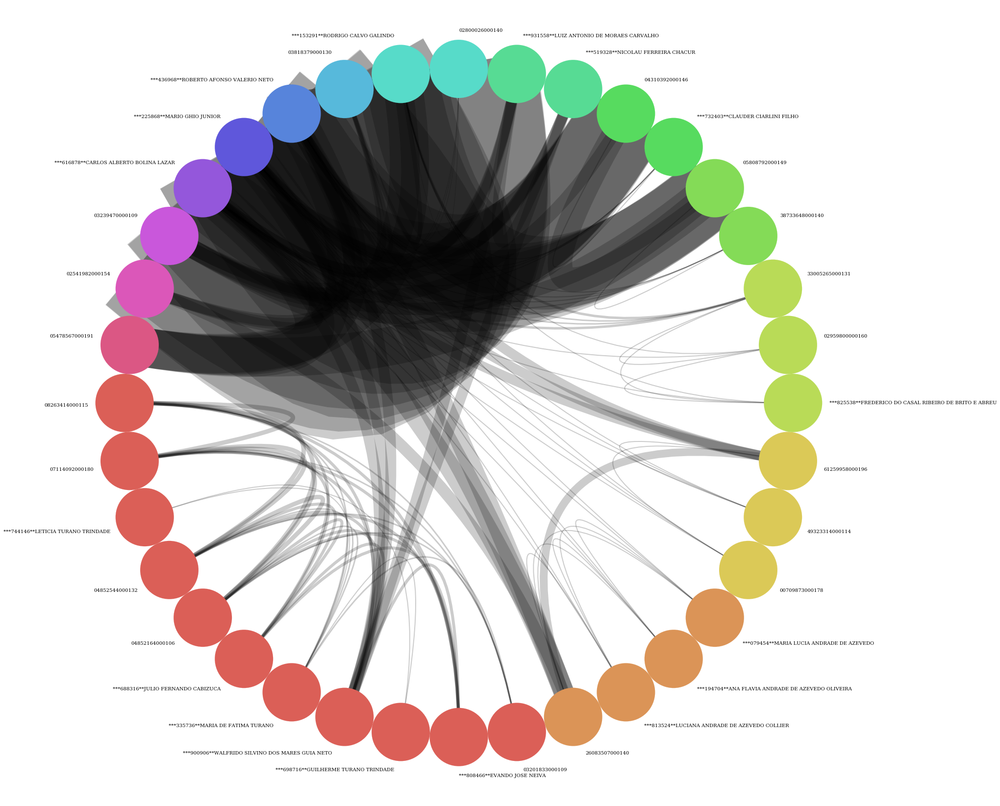

In [118]:
c = CircosPlot(
    G_new,
    dpi=600,
#     node_grouping="weight",
    edge_width="weight",
    figsize=(30, 30),
    node_color="community",
    node_labels=True,
)
c.draw()
# plt.legend()
plt.show()

In [ ]:
for key, G in graphs.items():
    print("\n", key)
    eigenvector = nx.eigenvector_centrality(G)
    sorted(eigenvector.items(), key=lambda x:x[1], reverse=True)[0:10]
    print("---")

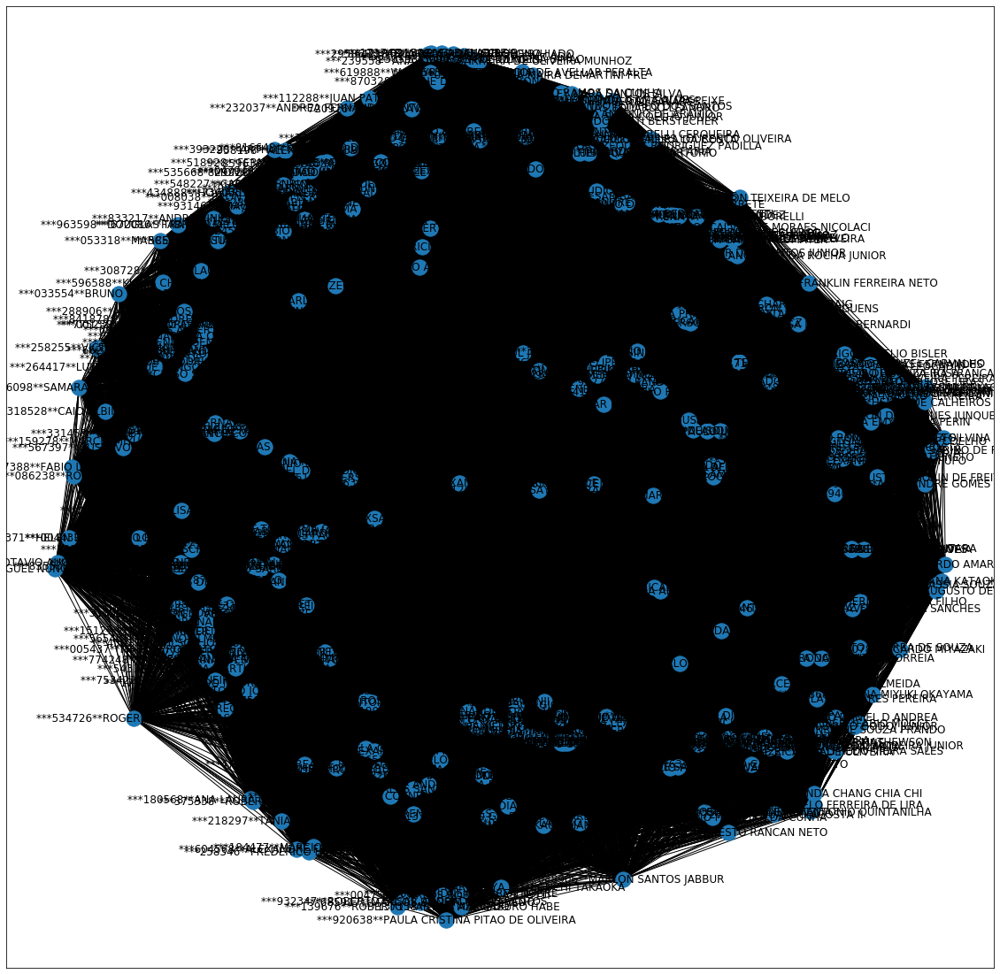

In [108]:
plt.figure(figsize=(20,20))
nx.draw_networkx(G_SOC.subgraph(largest_cc[SOCIOS]))

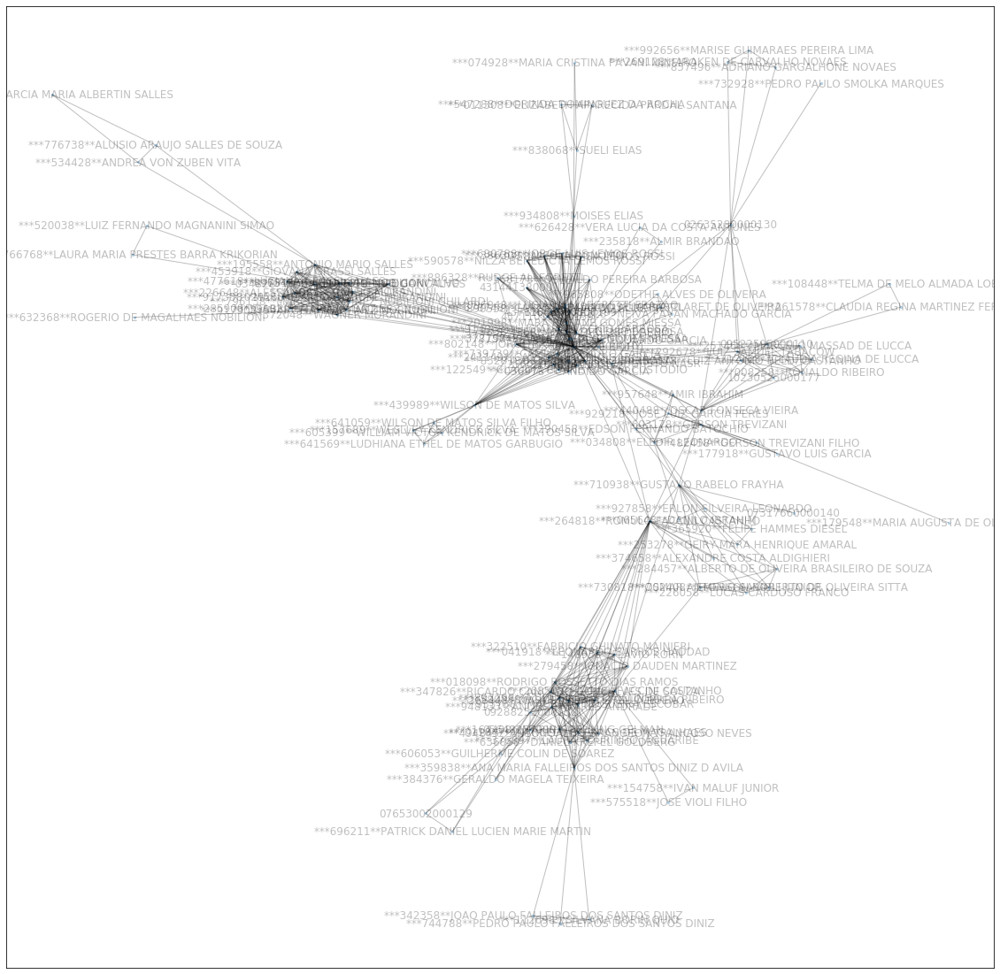

In [121]:
plt.figure(figsize=(20,20))
nx.draw_networkx(G_SOC.subgraph(ccomponents[SOCIOS][1]), alpha=0.25, node_size=5)

In [122]:
test = G_SOC.subgraph(ccomponents[SOCIOS][1])

In [123]:
test['***616878**CARLOS ALBERTO BOLINA LAZAR']

KeyError: 'Key ***616878**CARLOS ALBERTO BOLINA LAZAR not found'

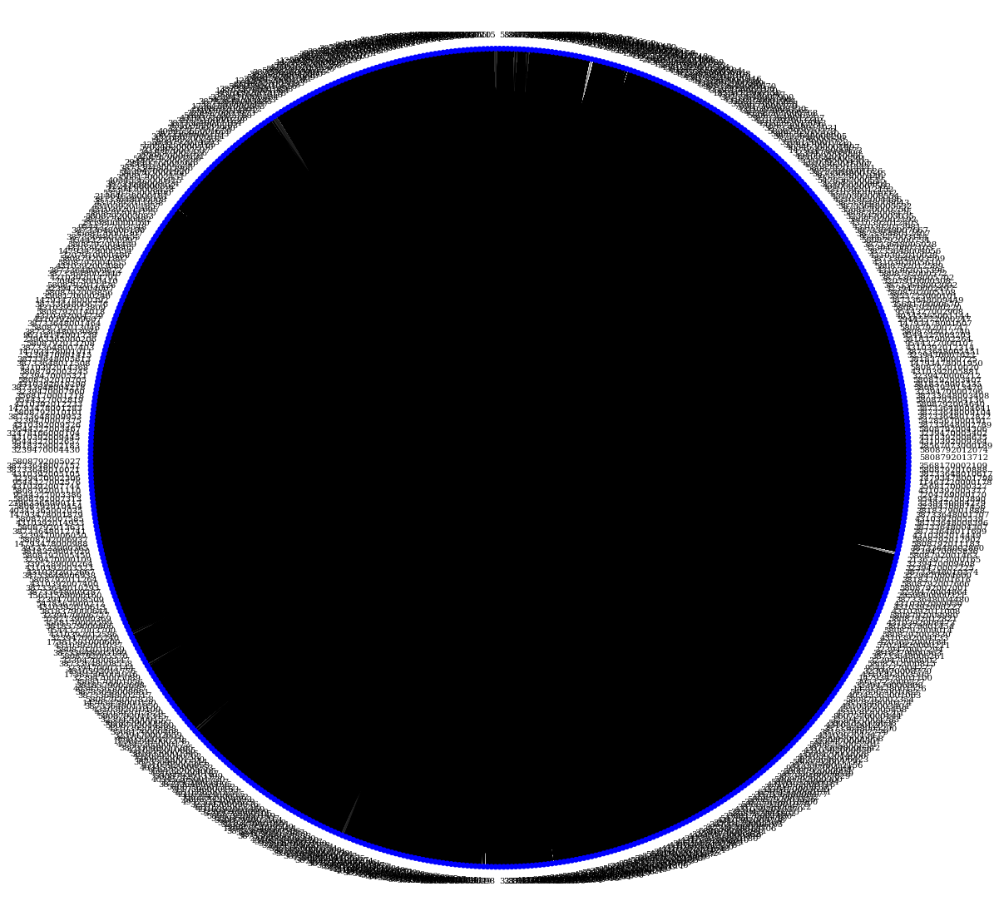

In [17]:
c = CircosPlot(
    G_EMP.subgraph(largest_cc[EMPRESAS]),
    dpi=600,
#     node_grouping="weight",
    edge_width="weight",
    figsize=(20, 20),
#     node_color="tipo_socio",
    node_labels=True,
)
c.draw()
plt.show()

In [85]:
test = [f[0] for f in baron_companies[0:20]]

In [87]:
remanescentes = []
for t in test:
    if t in G_EMP:
        remanescentes.append(t)
        print(t, 'SIM')
    else:
        print(t, 'N')

38733648000140 SIM
04310392000146 N
07728655000120 N
05808792000149 SIM
08432514000128 N
08807432000110 N
18570214000169 N
04986320000113 N
05478567000191 N
17765891000170 SIM
06099229000101 N
20512706000140 N
56012628000161 SIM
26083507000140 N
03239470000109 N
19213316000190 N
10305610000157 N
62596408000125 N
09288252000132 N
15539941000175 N


In [89]:
barons_companies_cc = {}
for baron in remanescentes:
    already = False
    for B, G in barons_companies_cc.items():
        if baron in G:
            already = True
            print(baron, "in", B, "component")
            break
    if not already:
        barons_companies_cc[baron] = G_EMP.subgraph(nx.node_connected_component(G_EMP, baron)).copy()
        print("Added component of size {} for {}".format(len(barons_companies_cc[baron]), baron))

Added component of size 6 for 38733648000140
05808792000149 in 38733648000140 component
Added component of size 5 for 17765891000170
Added component of size 7 for 56012628000161


38733648000140


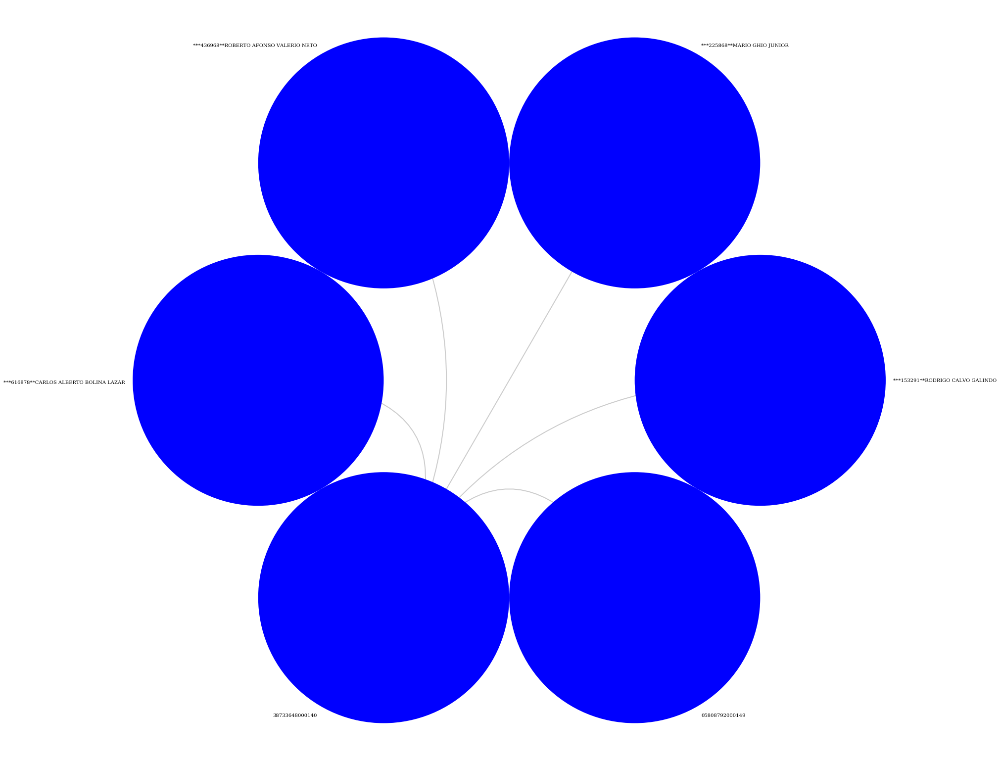

17765891000170


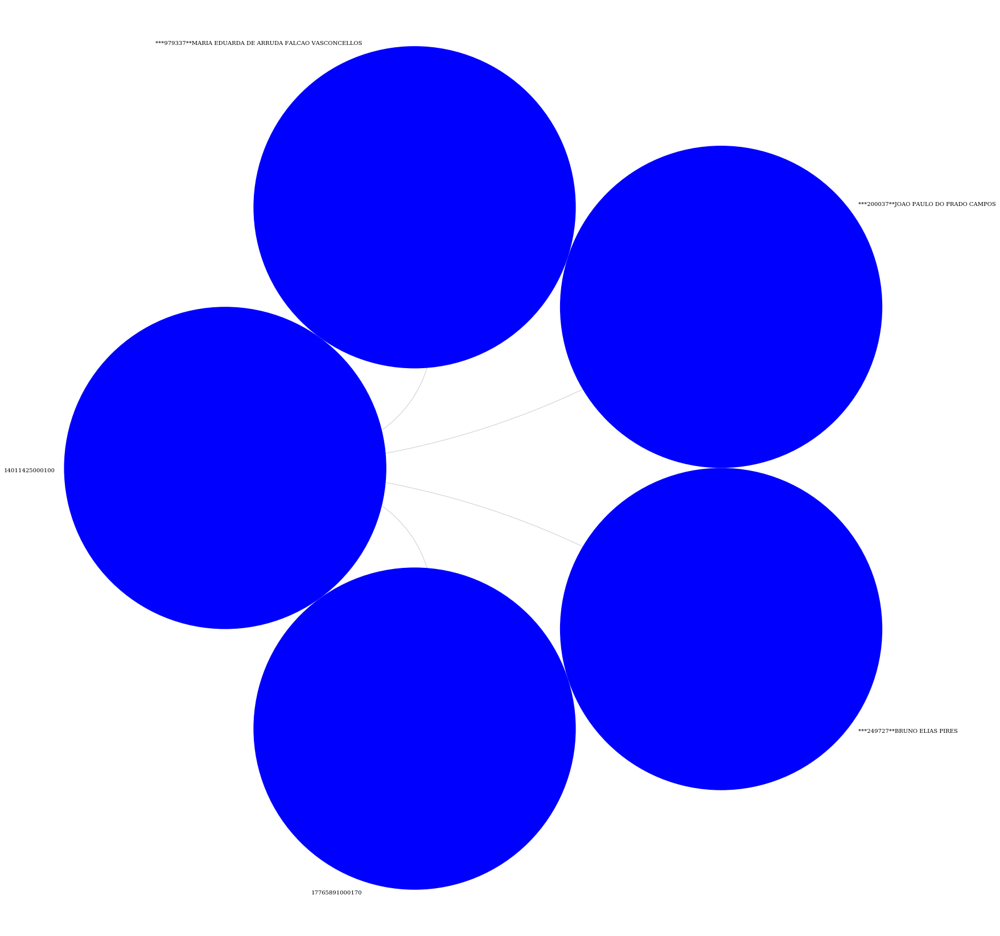

56012628000161


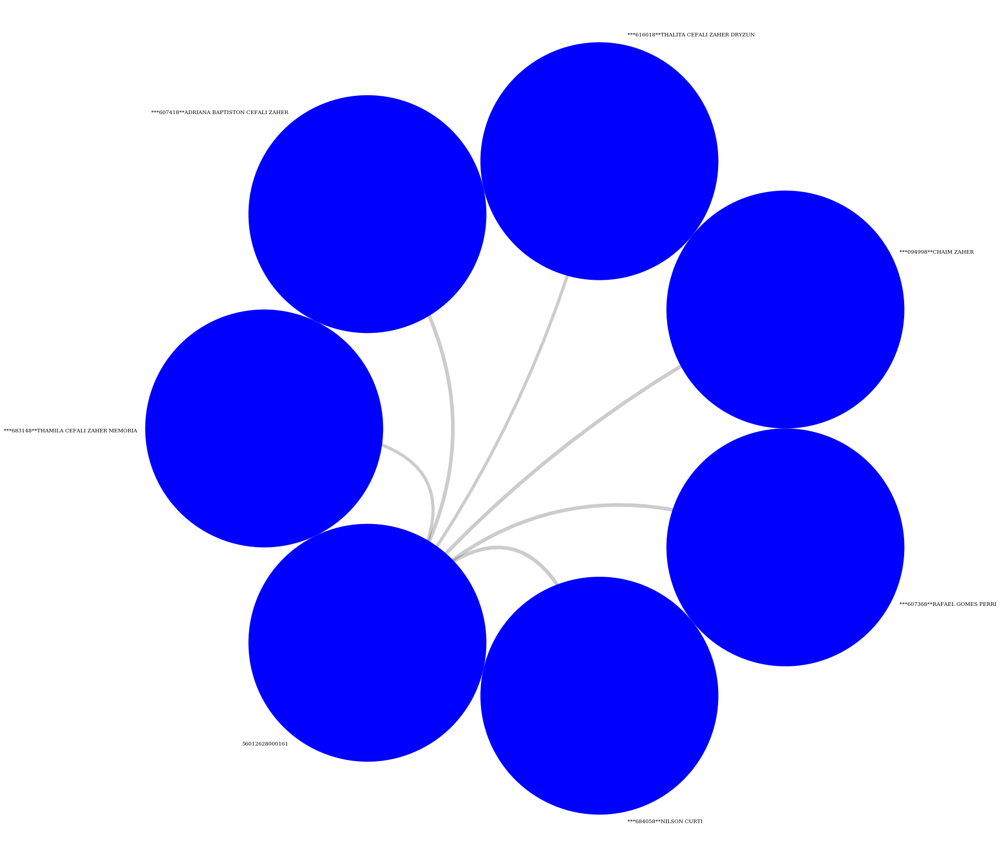

In [90]:
for key, G in barons_companies_cc.items():
    c = CircosPlot(
        G,
        dpi=600,
    #     node_grouping="weight",
        edge_width="weight",
        figsize=(30, 30),
#         node_color="tipo_socio",
        node_labels=True,
    )
    print(key)
    c.draw()
    # plt.legend()
    plt.show()

In [ ]:
list(nx.find_cliques(barons_cc[]))